<a href="https://colab.research.google.com/github/Aditya21Hebbar/Demand-Prediction-ML-Project/blob/main/project_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Jovian Commit Essentials
# Please retain and execute this cell without modifying the contents for `jovian.commit` to work
!pip install jovian --upgrade -q
import jovian
jovian.set_project('project-3')
jovian.set_colab_id('1Bk2UwFKuSq_tIldjY8cvdTwlqwJy8C3C')

# Demand prediction based on the Ad created

![Imgur](https://i.imgur.com/1da2qMw.jpg)

# Introduction

Description of the challenge taken from competetion page :
When selling used goods online, a combination of little things can make a large difference.

And, even with an optimized product listing, demand for a product may simply not exist–frustrating sellers who may have over-invested in marketing.
Avito, Russia’s largest classified advertisements website, is deeply familiar with this problem. Sellers on their platform sometimes feel frustrated with both too little demand (indicating something is wrong with the product or the product listing) or too much demand (indicating a hot item with a good description was underpriced).



Avito is one of the biggest classified advertisment website. In this project we are trying to predict the `deal_probability` using machine learning model before which we perform some operations related to data cleaning, visualization etc to understand the data. So that we can determine which are the essential factors for successfull `deal_probability`.



# Evaluation Criteria
The regression model should be evaulated for Root Mean Squared Error 𝑅𝑀𝑆𝐸. 

RMSE is defined as:
 


$$\ {RMSE} = \sqrt{\frac{1}{n} \sum_{i=1}^{n} 𝑦𝑖−𝑦̂ 𝑖^2}$$

  
where y hat is the predicted value and y is the original value.

# Install and Import Libraries

In [ ]:
!pip install jovian --upgrade --quiet

In [ ]:
import jovian

In [ ]:
# Execute this to save new versions of the notebook
jovian.commit(project="project-3")

[jovian] Detected Colab notebook...
[jovian] Please enter your API key ( from https://jovian.ai/ ):
API KEY: ··········
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

In [ ]:
import numpy as np 
import pandas as pd 
import os




from sklearn import metrics
from sklearn.metrics import mean_squared_error
from sklearn import feature_selection
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
import random

import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from plotly import graph_objects as go

import matplotlib
%matplotlib inline

sns.set_style("darkgrid")
matplotlib.rcParams['font.size'] = 16
matplotlib.rcParams['figure.figsize'] = (12, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [ ]:
! pip install -q kaggle #installing kaggle to import dataset

In [ ]:
from google.colab import files #uploading kaggle credentials
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"adityanhebbar","key":"6edc9d513f781b0a82da87b0cd6c6aaa"}'}

In [ ]:
! mkdir ~/.kaggle

In [ ]:
! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

# Downloading Dataset from kaggle
![Imgur](https://i.imgur.com/CpwcLkq.png)

### Downloading Data

There may be different sources to get the data:
* CSV files
* SQL databases
* Raw File URLs
* Kaggle datasets 
* Google Drive
* Dropbox
* etc.

Identify the right tool/library to get the data. 

For avito price prediction let us download the dataset from kaggle dataset 
 https://www.kaggle.com/competitions/avito-demand-prediction/data
 
 Kaggle, a subsidiary of Google LLC, is an online community of data scientists and machine learning practitioners. Kaggle allows users to find and publish data sets, explore and build models in a web-based data-science environment, work with other data scientists and machine learning engineers, and enter competitions to solve data science challenges.

Kaggle got its start in 2010 by offering machine learning competitions and now also offers a public data platform, a cloud-based workbench for data science, and Artificial Intelligence education.

In [ ]:
! kaggle competitions download avito-demand-prediction -f train.csv  
! kaggle competitions download avito-demand-prediction -f test.csv 
! kaggle competitions download avito-demand-prediction -f sample_submission.csv

 99% 315M/318M [00:02<00:00, 139MB/s]
100% 318M/318M [00:02<00:00, 132MB/s]
 88% 97.0M/111M [00:00<00:00, 125MB/s]
100% 111M/111M [00:00<00:00, 122MB/s] 
  0% 0.00/3.95M [00:00<?, ?B/s]
100% 3.95M/3.95M [00:00<00:00, 244MB/s]


In [ ]:
! unzip train.csv # ! unzip train_active.csv 
! unzip test.csv # ! unzip test_active.csv 
! unzip sample_submission.csv # ! unzip sample_submission.csv 

Archive:  train.csv.zip
  inflating: train.csv               
Archive:  test.csv.zip
  inflating: test.csv                
Archive:  sample_submission.csv.zip
  inflating: sample_submission.csv   


# Reading and converting files to CSV for easy usage 

In [ ]:
pd.options.display.max_columns = 200
pd.options.display.max_rows = 200

train_df = pd.read_csv("train.csv")
print('train length', len(train_df))

train length 1503424


In [ ]:
test_df = pd.read_csv("test.csv")
print('test length', len(test_df))

test length 508438


# Getting Basic Idea About Data

In [ ]:
train_df.sample(4) #display sample of data from train_df

,item_id,user_id,region,city,parent_category_name,category_name,param_1,param_2,param_3,title,description,price,item_seq_number,activation_date,user_type,image,image_top_1,deal_probability
170342,1b86a184314b,aef9aa047734,Челябинская область,Златоуст,Бытовая электроника,Аудио и видео,Телевизоры и проекторы,NaN,NaN,Samsung cs-21z43zgq slim FIT TV,диагональ 54 см (21 дюйм) экран плоский состоя...,2500.0,840,2017-03-19,Company,d1562afe4bbeb01a0578cd6d732f9702bd59158389c0bd...,3022.0,0.00000
133581,6801c88d74ff,5b27e5b42b1e,Свердловская область,Каменск-Уральский,Для дома и дачи,Бытовая техника,Климатическое оборудование,Обогреватели,NaN,Простынь с электроподогревом,Размер 800×1500. Новая,1600.0,20,2017-03-25,Private,136b898f1ec7fa1011b1d651e08dbfbf2d36b2ff053bf6...,671.0,0.00000
731518,75f737983ad6,7e67c780ffa6,Тюменская область,Тюмень,Недвижимость,Квартиры,Сдам,На длительный срок,1,"1-к квартира, 31 м², 3/5 эт.",Сдам 1 ккв на длительный срок. Фото реальные. ...,11000.0,146,2017-03-28,Company,eca4ce101bb938f5aa978769925b8aa77d86d66e615a46...,2219.0,0.03866
43526,b853c5f05832,a8f76e9334d4,Свердловская область,Екатеринбург,Личные вещи,"Одежда, обувь, аксессуары",Женская одежда,Обувь,38,Новые женские кроссовки new balance 574,Новые женские кроссовки new balance 574/\nРазм...,2500.0,9427,2017-03-21,Company,404e3c274bf7625ace91ff1de178c7150ed6d7449b6b7a...,481.0,0.12579


In [ ]:
test_df.sample(4) # display sample of data from test_df

,item_id,user_id,region,city,parent_category_name,category_name,param_1,param_2,param_3,title,description,price,item_seq_number,activation_date,user_type,image,image_top_1
437916,7b71c23f4084,8ae5057fc3d0,Нижегородская область,Дзержинск,Для дома и дачи,Мебель и интерьер,Столы и стулья,NaN,NaN,Стол компьютерный,Стол компьютерный,1500.0,3,2017-04-17,Private,9e29ca3db63746f7a7aaeb21d9533db7f8210c67e21a4b...,1450.0
358214,c52278636910,119f71cbd0c2,Пермский край,Губаха,Животные,Собаки,Немецкая овчарка,NaN,NaN,Немец,"Прадаеться девочка немецкой овчарки 5.5мес, оч...",7000.0,59,2017-04-14,Company,15abf7df0eb2dff652ecde7f569e0d257d8f66f2c70905...,2155.0
309514,d1e688f6902c,2640e1774688,Свердловская область,Екатеринбург,Хобби и отдых,Коллекционирование,Открытки,NaN,NaN,Открытки Третьяковской галереи,Продам наборы открыток Третьяковской галереи 2...,300.0,44,2017-04-16,Private,5bbc5bda50430fae9a229428139a513160996a0d5aced6...,2396.0
340585,82135a72b11e,9f68b2ada22a,Тульская область,Щекино,Недвижимость,"Дома, дачи, коттеджи",Продам,Дом,NaN,Дом 68.5 м² на участке 4.5 сот.,Продается 1/2 часть дома по ул. 2-ой Поселковы...,2300000.0,34,2017-04-15,Private,d72297e38bdbd159a4c6ac19dd2df6901360af99a06fec...,1295.0


# Item description
 So looking above we can say that
  - item_id - Ad id.
  - user_id - User id.
  - region - Ad region.
  - city - Ad city.
  - parent_category_name - Top level ad category as classified by Avito's ad model.
  - category_name - Fine grain ad category as classified by Avito's ad model.
  - param_1 - Optional parameter from Avito's ad model.
  - param_2 - Optional parameter from Avito's ad model.
  - param_3 - Optional parameter from Avito's ad model.
  - title - Ad title.
  - description - Ad description.
  - price - Ad price.
  - item_seq_number - Ad sequential number for user.
  - activation_date- Date ad was placed.
  - user_type - User type.
  - image - Id code of image. Ties to a jpg file in train_jpg. Not every ad has an image.
  - image_top_1 - Avito's classification code for the image.
  - **deal_probability** - The target variable. This is the likelihood that an ad - actually sold something. It's not possible to verify every transaction with certainty, so this column's value can be any float from zero to one.

# Cleaning data



The first step is to check the column data types and identify if there are any null values.
So by using `info()` we can get whole lot of information about our data


In [ ]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1503424 entries, 0 to 1503423
Data columns (total 18 columns):
 #   Column                Non-Null Count    Dtype  
---  ------                --------------    -----  
 0   item_id               1503424 non-null  object 
 1   user_id               1503424 non-null  object 
 2   region                1503424 non-null  object 
 3   city                  1503424 non-null  object 
 4   parent_category_name  1503424 non-null  object 
 5   category_name         1503424 non-null  object 
 6   param_1               1441848 non-null  object 
 7   param_2               848882 non-null   object 
 8   param_3               640859 non-null   object 
 9   title                 1503424 non-null  object 
 10  description           1387148 non-null  object 
 11  price                 1418062 non-null  float64
 12  item_seq_number       1503424 non-null  int64  
 13  activation_date       1503424 non-null  object 
 14  user_type             1503424 non-

In [ ]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 508438 entries, 0 to 508437
Data columns (total 17 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   item_id               508438 non-null  object 
 1   user_id               508438 non-null  object 
 2   region                508438 non-null  object 
 3   city                  508438 non-null  object 
 4   parent_category_name  508438 non-null  object 
 5   category_name         508438 non-null  object 
 6   param_1               485528 non-null  object 
 7   param_2               275209 non-null  object 
 8   param_3               202107 non-null  object 
 9   title                 508438 non-null  object 
 10  description           508438 non-null  object 
 11  price                 477853 non-null  float64
 12  item_seq_number       508438 non-null  int64  
 13  activation_date       508438 non-null  object 
 14  user_type             508438 non-null  object 
 15  

Here we are Selecting the columns which are needed from the train and test dataframes. One thing that we can observe here is that `item_seq_number` can be of no use thus removing it from dataset. and we are changing `price` datatype from float64 to float32  for memory efficiency and `user_type` from object to categorical data since its categorical type

In [ ]:
selected_columns = ['item_id', 
                    'user_id', 
                    'region', 
                    'city', 
                    'parent_category_name', 
                    'category_name',
                    'param_1',
                    'param_2',
                    'param_3',
                    'title', 
                    'description',
                    'price',
                    'activation_date',
                    'user_type',
                    'image_top_1',
                    'deal_probability']

selected_dtypes = {
    'price': 'float32',
    'user_type': 'category'
}

In [ ]:
select_columns = ['item_id', 
                  'user_id', 
                  'region', 
                  'city', 
                  'parent_category_name', 
                  'category_name', 
                  'param_1',
                  'param_2',
                  'param_3', 
                  'title', 
                  'description', 
                  'price',
                  'activation_date',
                  'user_type',
                  'image_top_1']

selected_dtypes = {
    'price': 'float32',
    'user_type': 'category'
}

Let us load the data with selected columns, selected dtypes and since `activation_date` belongs to date category we can parse that using `parse_date`

In [ ]:
train_df = pd.read_csv('/content/train.csv',
                        usecols=selected_columns,
                        dtype=selected_dtypes,
                        index_col='item_id',
                        parse_dates=['activation_date']
)

Let us do the same for test data i.e `test_df`


In [ ]:
test_df = pd.read_csv('/content/test.csv', 
                      usecols=select_columns,
                      dtype=selected_dtypes,
                      index_col='item_id',
                      parse_dates=['activation_date']
)

Let us view the length of `train_df` and `test_df` respectively

In [ ]:
len(train_df), len(test_df)

(1503424, 508438)

So the length of `train_df` is around 1052397 and length of `test_df` is around 508438 

In [ ]:
train_df.head() # to view the top rows of the train_df after modification

,user_id,region,city,parent_category_name,category_name,param_1,param_2,param_3,title,description,price,activation_date,user_type,image_top_1,deal_probability
item_id,,,,,,,,,,,,,,,
b912c3c6a6ad,e00f8ff2eaf9,Свердловская область,Екатеринбург,Личные вещи,Товары для детей и игрушки,Постельные принадлежности,NaN,NaN,Кокоби(кокон для сна),"Кокон для сна малыша,пользовались меньше месяц...",400.0,2017-03-28,Private,1008.0,0.12789
2dac0150717d,39aeb48f0017,Самарская область,Самара,Для дома и дачи,Мебель и интерьер,Другое,NaN,NaN,Стойка для Одежды,"Стойка для одежды, под вешалки. С бутика.",3000.0,2017-03-26,Private,692.0,0.00000
ba83aefab5dc,91e2f88dd6e3,Ростовская область,Ростов-на-Дону,Бытовая электроника,Аудио и видео,"Видео, DVD и Blu-ray плееры",NaN,NaN,Philips bluray,"В хорошем состоянии, домашний кинотеатр с blu ...",4000.0,2017-03-20,Private,3032.0,0.43177
02996f1dd2ea,bf5cccea572d,Татарстан,Набережные Челны,Личные вещи,Товары для детей и игрушки,Автомобильные кресла,NaN,NaN,Автокресло,Продам кресло от0-25кг,2200.0,2017-03-25,Company,796.0,0.80323
7c90be56d2ab,ef50846afc0b,Волгоградская область,Волгоград,Транспорт,Автомобили,С пробегом,ВАЗ (LADA),2110,"ВАЗ 2110, 2003",Все вопросы по телефону.,40000.0,2017-03-16,Private,2264.0,0.20797


One of the importent thing in data cleaning is to clean dataset from missing values, So let us try to remove those from the dataset

In [ ]:
train_df.isnull().mean() < 0.2

user_id                  True
region                   True
city                     True
parent_category_name     True
category_name            True
param_1                  True
param_2                 False
param_3                 False
title                    True
description              True
price                    True
activation_date          True
user_type                True
image_top_1              True
deal_probability         True
dtype: bool

In [ ]:
train_df.isnull().isna().sum()

user_id                 0
region                  0
city                    0
parent_category_name    0
category_name           0
param_1                 0
param_2                 0
param_3                 0
title                   0
description             0
price                   0
activation_date         0
user_type               0
image_top_1             0
deal_probability        0
dtype: int64

In [ ]:
train_df = train_df[train_df.columns[train_df.isnull().mean() < 0.2]] # Eliminating data with less than 20% data

So finally we can say that we have removed the null data from the dataset.

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

## Dropping duplicates from train and test data

In [ ]:
train_df[train_df.duplicated()]

,user_id,region,city,parent_category_name,category_name,param_1,title,description,price,activation_date,user_type,image_top_1,deal_probability
item_id,,,,,,,,,,,,,
1b373f278e26,de5f68d1805d,Красноярский край,Красноярск,Личные вещи,"Одежда, обувь, аксессуары",Мужская одежда,Мужской свитшот Reebok,Размерный ряд : 46-54/\nДоставка по городу : 2...,1990.0,2017-03-19,Company,629.0,0.0
17b228302d8d,7567886ce221,Новосибирская область,Новосибирск,Личные вещи,Детская одежда и обувь,Для девочек,Платье,Смотреть на выборной,150.0,2017-03-28,Private,82.0,0.0
ae0059b91730,6240fe9ae566,Самарская область,Тольятти,Бытовая электроника,Аудио и видео,"Видео, DVD и Blu-ray плееры",Караоке,NaN,1500.0,2017-03-21,Private,3042.0,0.0
5d34ef478959,b07ec089138a,Оренбургская область,Бузулук,Личные вещи,"Одежда, обувь, аксессуары",Мужская одежда,Мужская рубашка,NaN,400.0,2017-03-16,Company,635.0,0.0
252b8eff8c36,cdb2525d867a,Самарская область,Самара,Личные вещи,Детская одежда и обувь,Для мальчиков,Брюки,NaN,50.0,2017-03-17,Private,70.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
0c991770071b,972306098072,Саратовская область,Энгельс,Личные вещи,"Одежда, обувь, аксессуары",Женская одежда,Джинсы размер 30,NaN,500.0,2017-03-21,Private,567.0,0.0
d1b0a21e9e60,77bcfcf964f4,Удмуртия,Ижевск,Личные вещи,"Одежда, обувь, аксессуары",Мужская одежда,Рубашка Tommy Hilfiger,"Оригинал, в отличном состоянии.",800.0,2017-03-20,Private,635.0,0.0
e20eabccd509,d6c7302fcebd,Ростовская область,Ростов-на-Дону,Личные вещи,"Одежда, обувь, аксессуары",Женская одежда,Джинсы Frankie morello,NaN,2500.0,2017-03-20,Private,567.0,0.0


In [ ]:
train_df.drop_duplicates(inplace=True)

Finally we can say that we have removed `1948 rows` of duplicated data.

Let us also parse the date column

In [ ]:
train_df['month'] = train_df.activation_date.dt.month
train_df['dayofmonth'] = train_df.activation_date.dt.day
train_df['year'] = train_df.activation_date.dt.year
train_df['dayofweek'] = train_df.activation_date.dt.weekday
train_df['isweekend'] = (train_df.activation_date.dt.weekday > 4).astype(int)

In [ ]:
train_df.info() # let us see what happened to our train_df

<class 'pandas.core.frame.DataFrame'>
Index: 1501476 entries, b912c3c6a6ad to 9ad3b7bff1db
Data columns (total 18 columns):
 #   Column                Non-Null Count    Dtype         
---  ------                --------------    -----         
 0   user_id               1501476 non-null  object        
 1   region                1501476 non-null  object        
 2   city                  1501476 non-null  object        
 3   parent_category_name  1501476 non-null  object        
 4   category_name         1501476 non-null  object        
 5   param_1               1439929 non-null  object        
 6   title                 1501476 non-null  object        
 7   description           1385979 non-null  object        
 8   price                 1416187 non-null  float32       
 9   activation_date       1501476 non-null  datetime64[ns]
 10  user_type             1501476 non-null  category      
 11  image_top_1           1388897 non-null  float64       
 12  deal_probability      1501476 n

Here, let us do the same thing for `test_df` as well.

In [ ]:
test_df['month'] = test_df.activation_date.dt.month
test_df['dayofmonth'] = test_df.activation_date.dt.day
test_df['year'] = test_df.activation_date.dt.year
test_df['dayofweek'] = test_df.activation_date.dt.weekday
test_df['isweekend'] = (test_df.activation_date.dt.weekday > 4).astype(int)

In [ ]:
#Updating train shape and test shape
train_shape = train_df.shape
test_shape = test_df.shape

print("train data shape:", train_shape)
print("test data shape:", test_shape)

train data shape: (1501476, 18)
test data shape: (508438, 19)


In [ ]:
#Statstical Summary
train_description = train_df.describe()

print(train_description)

              price   image_top_1  deal_probability         month  \
count  1.416187e+06  1.388897e+06      1.501476e+06  1.501476e+06   
mean   3.170691e+05  1.242631e+03      1.392986e-01  3.000006e+00   
std    6.693580e+07  9.704259e+02      2.601905e-01  2.448279e-03   
min    0.000000e+00  0.000000e+00      0.000000e+00  3.000000e+00   
25%    5.000000e+02  4.250000e+02      0.000000e+00  3.000000e+00   
50%    1.300000e+03  1.057000e+03      0.000000e+00  3.000000e+00   
75%    7.000000e+03  2.217000e+03      1.512100e-01  3.000000e+00   
max    7.950101e+10  3.066000e+03      1.000000e+00  4.000000e+00   

         dayofmonth       year     dayofweek     isweekend  
count  1.501476e+06  1501476.0  1.501476e+06  1.501476e+06  
mean   2.155646e+01     2017.0  2.942408e+00  2.810408e-01  
std    4.045810e+00        0.0  2.031348e+00  4.495075e-01  
min    1.000000e+00     2017.0  0.000000e+00  0.000000e+00  
25%    1.800000e+01     2017.0  1.000000e+00  0.000000e+00  
50%    2.200

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

# Exploratory Data Analysis and Visualization

Objectives of exploratory data analysis:

- Study the distributions of individual columns (uniform, normal, exponential)
- Detect anomalies or errors in the data (e.g. missing/incorrect values)
- Study the relationship of target column with other columns (linear, non-linear etc.)
- Gather insights about the problem and the dataset
- Come up with ideas for preprocessing and feature engineering


### Correlation between variables
Correlation refers to the relationship between two variables and how they might or might not change with respect to eachother. Understanding about correlation really helps us to create models in the later phase

                     price  image_top_1  deal_probability     month  \
price             1.000000     0.034378         -0.001100 -0.000009   
image_top_1       0.034378     1.000000          0.189790  0.001503   
deal_probability -0.001100     0.189790          1.000000  0.003554   
month            -0.000009     0.001503          0.003554  1.000000   
dayofmonth        0.000081     0.005706         -0.002398 -0.011566   
year              0.000000     0.000000          0.000000  0.000000   
dayofweek        -0.001174    -0.024729          0.002164  0.001409   
isweekend        -0.001431    -0.029965          0.000654  0.002100   

                  dayofmonth  year  dayofweek  isweekend  
price               0.000081   0.0  -0.001174  -0.001431  
image_top_1         0.005706   0.0  -0.024729  -0.029965  
deal_probability   -0.002398   0.0   0.002164   0.000654  
month              -0.011566   0.0   0.001409   0.002100  
dayofmonth          1.000000   0.0  -0.130222   0.072808  
year  

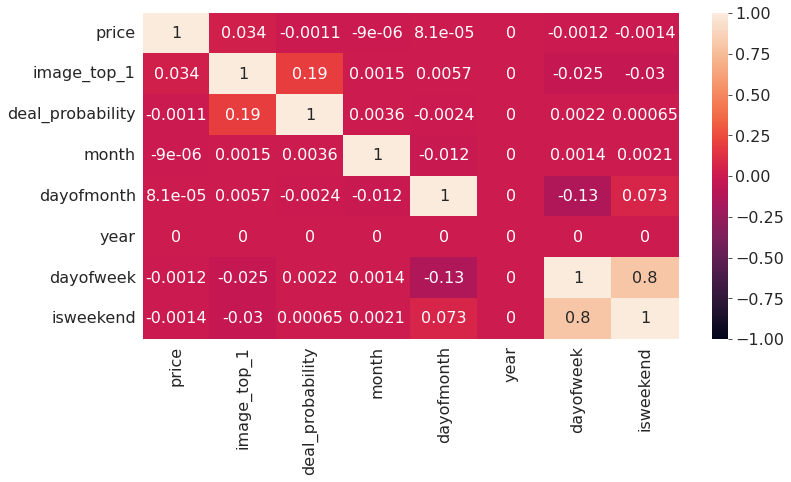

In [ ]:
 # Correlation Matrix formation
corr_matrix = train_df.corr(method='pearson')
corr_matrix.fillna(0, inplace=True) #imputing the Nan with 0
print(corr_matrix)

#Using heatmap to visualize the correlation matrix
sns.heatmap(corr_matrix, annot=True, vmin=-1, vmax=1);

## Checking the skew of data

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  """Entry point for launching an IPython kernel.


price               1183.139282
image_top_1            0.418036
deal_probability       1.902975
month                408.445835
dayofmonth            -0.005518
year                   0.000000
dayofweek              0.060294
isweekend              0.974220
dtype: float64


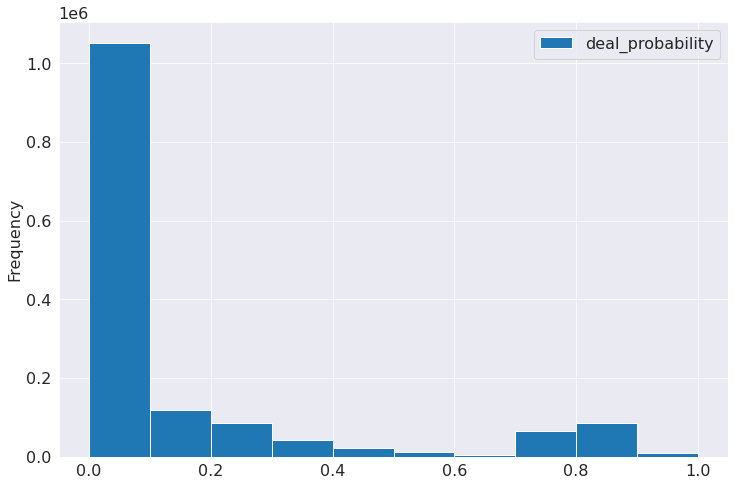

In [ ]:
skew = train_df.skew()
print(skew)
train_df.plot(kind='hist', x='price', y='deal_probability', figsize=(12, 8))
plt.show();

* A skewness value of 0 in the output denotes a symmetrical distribution of values.
* A negative skewness value in the output indicates an asymmetry in the distribution and the tail is larger towards the left hand side of the distribution.
* A positive skewness value in the output indicates an asymmetry in the distribution and the tail is larger towards the right hand side of the distribution.

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

## Checking the statistics of the price column

In [ ]:
train_df.price.min(), train_df.price.max(), train_df.price.std()

(0.0, 79501010000.0, 66935800.0)

Let us try to remove the outlier value from price column

In [ ]:
len(train_df)

1501476

Choosing a higher and lower values 
Higher = 420M
Lower = 60M

In [ ]:
# train_df.loc[train_df.price > 79501008896.0]
min_val = 0
max_val = 42100889
train_df = train_df[(train_df.price > min_val) & (train_df.price < max_val)]
train_df.head()

,user_id,region,city,parent_category_name,category_name,param_1,title,description,price,activation_date,user_type,image_top_1,deal_probability,month,dayofmonth,year,dayofweek,isweekend
item_id,,,,,,,,,,,,,,,,,,
b912c3c6a6ad,e00f8ff2eaf9,Свердловская область,Екатеринбург,Личные вещи,Товары для детей и игрушки,Постельные принадлежности,Кокоби(кокон для сна),"Кокон для сна малыша,пользовались меньше месяц...",400.0,2017-03-28,Private,1008.0,0.12789,3,28,2017,1,0
2dac0150717d,39aeb48f0017,Самарская область,Самара,Для дома и дачи,Мебель и интерьер,Другое,Стойка для Одежды,"Стойка для одежды, под вешалки. С бутика.",3000.0,2017-03-26,Private,692.0,0.00000,3,26,2017,6,1
ba83aefab5dc,91e2f88dd6e3,Ростовская область,Ростов-на-Дону,Бытовая электроника,Аудио и видео,"Видео, DVD и Blu-ray плееры",Philips bluray,"В хорошем состоянии, домашний кинотеатр с blu ...",4000.0,2017-03-20,Private,3032.0,0.43177,3,20,2017,0,0
02996f1dd2ea,bf5cccea572d,Татарстан,Набережные Челны,Личные вещи,Товары для детей и игрушки,Автомобильные кресла,Автокресло,Продам кресло от0-25кг,2200.0,2017-03-25,Company,796.0,0.80323,3,25,2017,5,1
7c90be56d2ab,ef50846afc0b,Волгоградская область,Волгоград,Транспорт,Автомобили,С пробегом,"ВАЗ 2110, 2003",Все вопросы по телефону.,40000.0,2017-03-16,Private,2264.0,0.20797,3,16,2017,3,0


Let us try to plot some graph to understand more about data

In [ ]:
px.scatter(train_df, x='price', y='year')

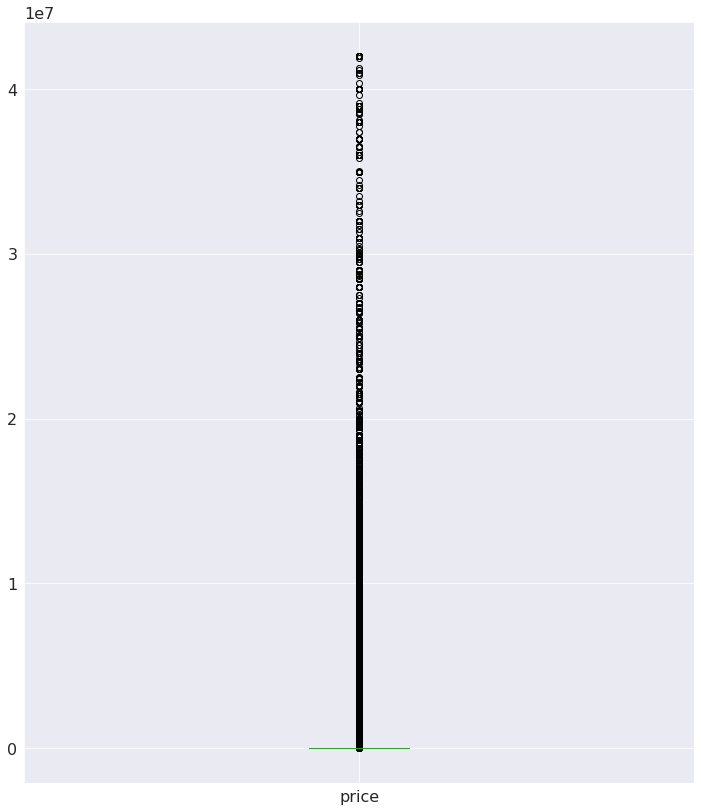

In [ ]:
train_df.price.plot(kind='box', figsize=(12, 14))
plt.show()

In [ ]:
train_df.deal_probability.isna().sum()

0

As we can see there are no null values in deal_probability of train_df.

In [ ]:
train_df['year'].value_counts()

2017    1411044
Name: year, dtype: int64

All the train and test data are for the year of `2017`. 

In [ ]:
train_df.month.value_counts()

3    1411035
4          9
Name: month, dtype: int64

All the data are for the month of `March` and `April`.

In [ ]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 508438 entries, 6544e41a8817 to d374d332992f
Data columns (total 19 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   user_id               508438 non-null  object        
 1   region                508438 non-null  object        
 2   city                  508438 non-null  object        
 3   parent_category_name  508438 non-null  object        
 4   category_name         508438 non-null  object        
 5   param_1               485528 non-null  object        
 6   param_2               275209 non-null  object        
 7   param_3               202107 non-null  object        
 8   title                 508438 non-null  object        
 9   description           508438 non-null  object        
 10  price                 477853 non-null  float32       
 11  activation_date       508438 non-null  datetime64[ns]
 12  user_type             508438 non-null  categor

In [ ]:
from pandas import set_option
set_option('display.width', 100)
set_option('precision', 3)


In [ ]:
set_option('display.width', 100)
set_option('precision', 3)

test_desc = test_df.describe()
print(test_desc)

           price  image_top_1     month  dayofmonth      year   dayofweek   isweekend
count  4.779e+05   465829.000  508438.0  508438.000  508438.0  508438.000  508438.000
mean   2.798e+05     1297.959       4.0      14.986    2017.0       2.764       0.231
std    5.364e+06      961.065       0.0       2.092       0.0       1.951       0.422
min    0.000e+00        0.000       4.0      12.000    2017.0       0.000       0.000
25%    5.000e+02      467.000       4.0      13.000    2017.0       1.000       0.000
50%    1.500e+03     1132.000       4.0      15.000    2017.0       3.000       0.000
75%    8.600e+03     2218.000       4.0      17.000    2017.0       4.000       0.000
max    3.000e+09     3066.000       4.0      20.000    2017.0       6.000       1.000


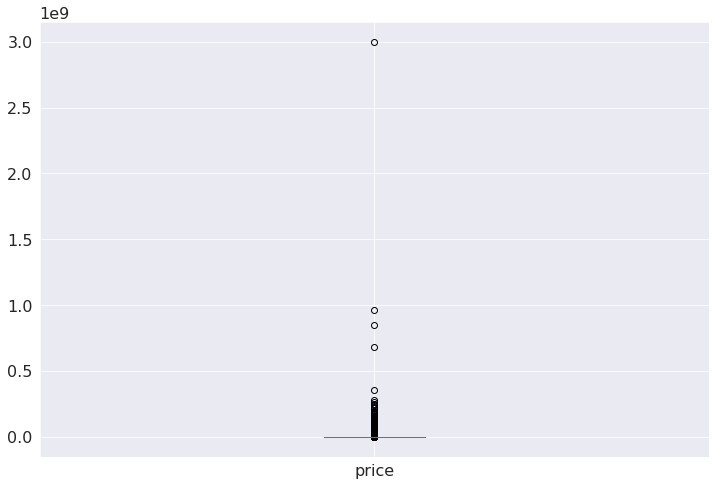

In [ ]:
test_df.price.plot(kind='box', figsize=(12, 8))
plt.show()

In [ ]:
test_df.price.min(), test_df.price.max(), test_df.price.median()

(0.0, 3000060000.0, 1500.0)

             price  image_top_1  month  dayofmonth  year  dayofweek  isweekend
price        1.000        0.043    0.0       0.002   0.0     -0.011     -0.012
image_top_1  0.043        1.000    0.0       0.021   0.0     -0.013     -0.005
month        0.000        0.000    0.0       0.000   0.0      0.000      0.000
dayofmonth   0.002        0.021    0.0       1.000   0.0     -0.298      0.135
year         0.000        0.000    0.0       0.000   0.0      0.000      0.000
dayofweek   -0.011       -0.013    0.0      -0.298   0.0      1.000      0.770
isweekend   -0.012       -0.005    0.0       0.135   0.0      0.770      1.000


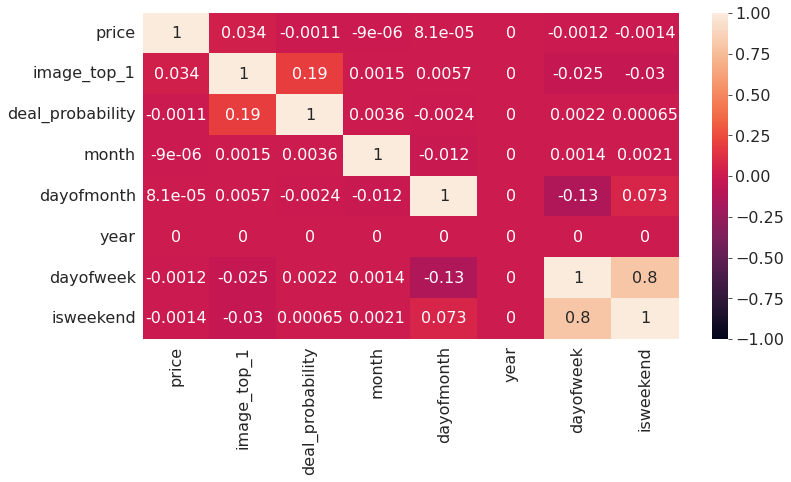

In [ ]:
set_option('display.width', 100)
set_option('precision', 3)
 
# Correlation Matrix 
corr_test = test_df.corr(method='pearson')
corr_test.fillna(0, inplace=True) #imputing the Nan with 0
print(corr_test)

#Using heatmap to visualize the correlation matrix
sns.heatmap(corr_matrix, annot=True, vmin=-1, vmax=1);

In [ ]:
test_df['year'].value_counts()

2017    508438
Name: year, dtype: int64

In [ ]:
test_df.month.value_counts()

4    508438
Name: month, dtype: int64

All the data are for the month of `April`.

In [ ]:
train_df.drop(["activation_date"],axis=1,inplace=True)

In [ ]:
test_df.drop(["activation_date"],axis=1,inplace=True)

In [ ]:
# Dropping param_2 and param_3 as these columns have less than 20% missinmg values 
test_df.drop(["param_2"],axis=1,inplace=True)
test_df.drop(["param_3"],axis=1,inplace=True)

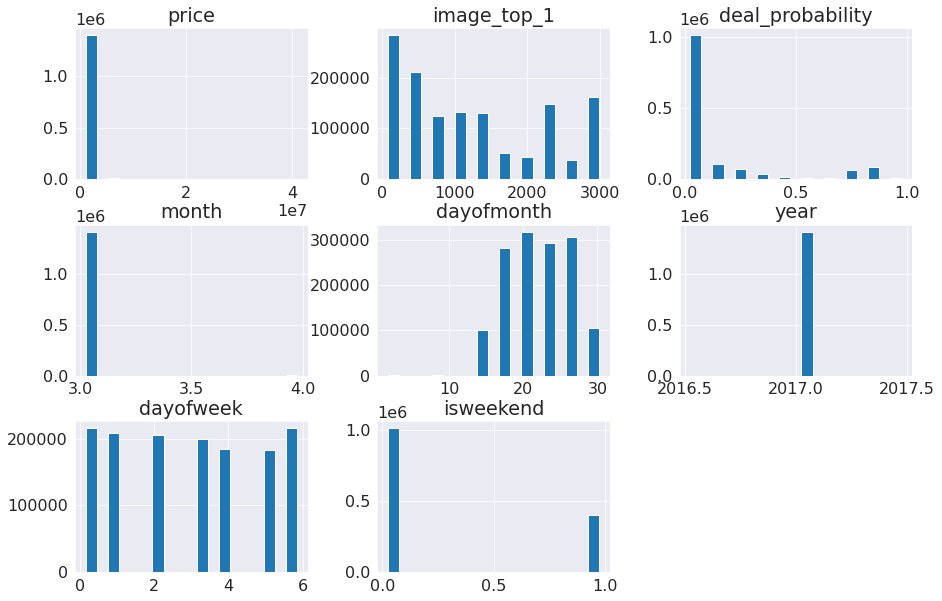

In [ ]:
from matplotlib import pyplot

train_df.hist(rwidth=0.5, figsize=(15,10))
pyplot.show();

Histogram groups data into bins and provide a count of number of observations in each bin. 
*

1.   `price` has a right skewness 
2.   `image_top_1` has the highest value in the beginning
3.   `deal_probability` has highest value around 0.1
4.   `month` value of 3 (March) is only available in the train dataset
5.   `dayofmonth` in the dataset ranges from 15th to 30th
6.   `year` value of 2017 is only availabe in the train dataset
7.   `dayofweek` has acceptable values 
8.   `isweekend` also has acceptable 0, 1 values


We get similar insights from the box plot as well.

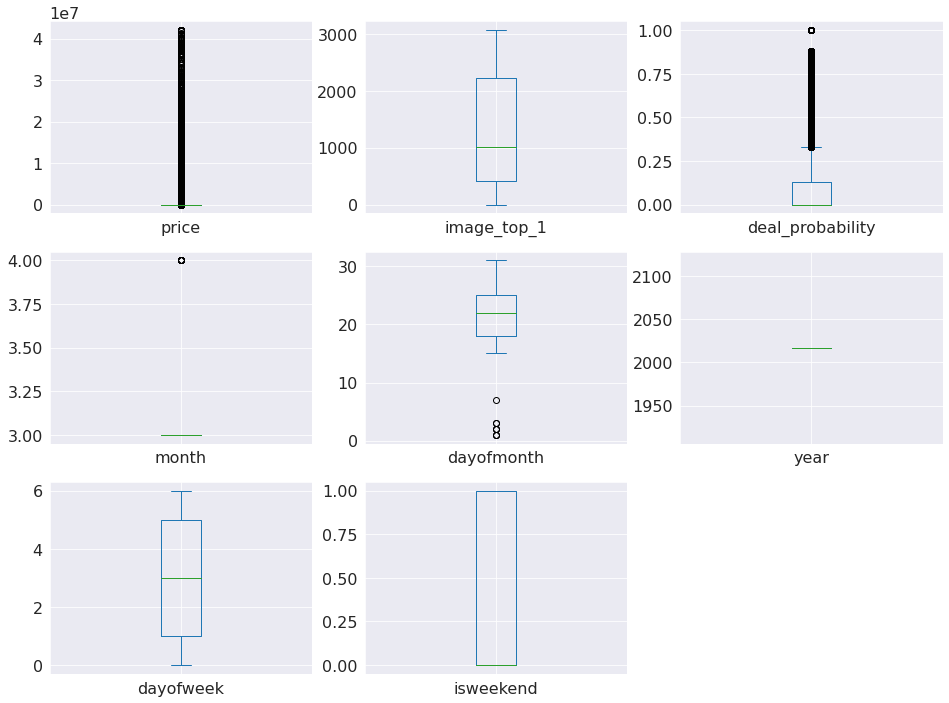

In [ ]:
train_df.plot(kind='box', subplots=True, layout=(3,3), figsize=(16,12))
pyplot.show();

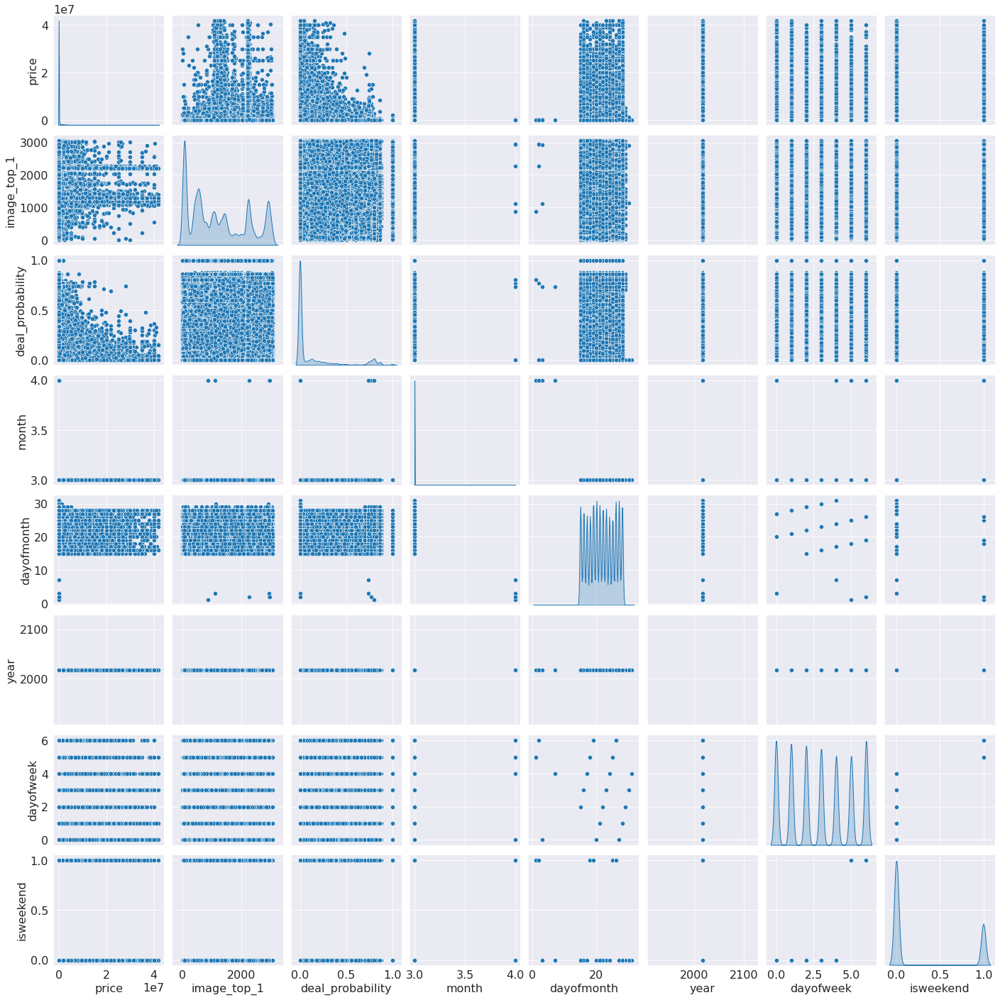

In [ ]:
##pairplots to get an intuition of potential correlations

sns.pairplot(train_df, diag_kind="kde");

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

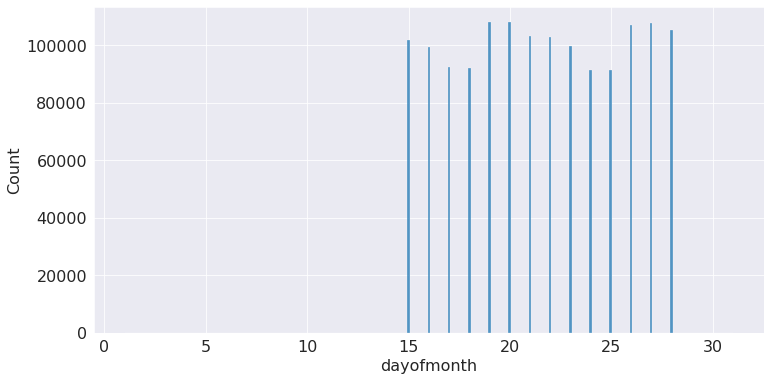

In [ ]:
sns.histplot(data=train_df, x='dayofmonth');

We see that not all days of the month the ads are activated. The days vary from 15th of the month through 28th of March (only month in the sample).

In [ ]:
train_df.dayofmonth.value_counts()

20    108018
19    107969
27    107822
26    107133
28    105456
21    103338
22    102811
15    101849
23     99768
16     99529
17     92492
18     92024
25     91510
24     91228
29        84
2          3
1          3
30         3
3          2
7          1
31         1
Name: dayofmonth, dtype: int64

In [ ]:
train_df['deal_probability'].isna().sum()

0

There are no null values for the target value `deal_probability` in the train data.

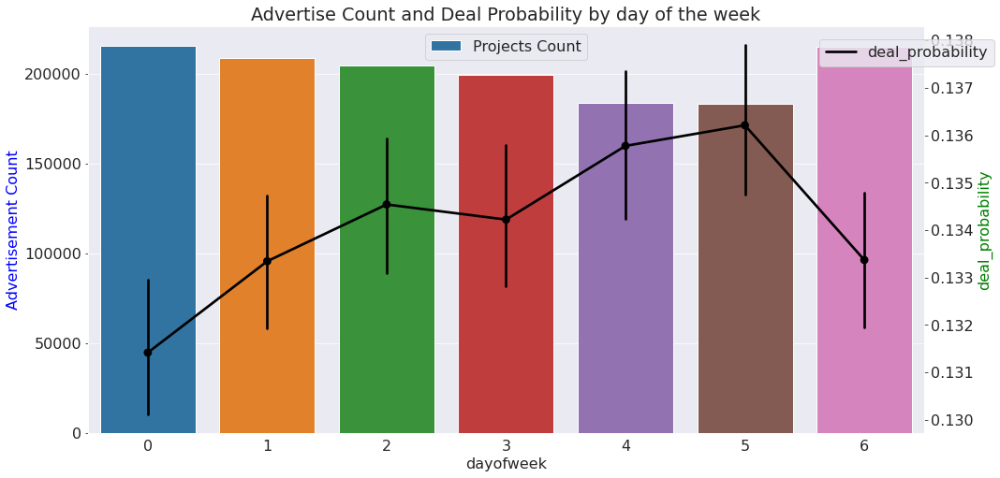

In [ ]:
fig, ax1 = plt.subplots(figsize=(16, 8))

plt.title("Advertise Count and Deal Probability by day of the week")

sns.countplot(x   = "dayofweek",
             data = train_df,
             ax   = ax1)

ax1.set_ylabel("Advertisement Count", color="b")

plt.legend(["Projects Count"])

ax2 = ax1.twinx()

sns.pointplot(x   = "dayofweek",
             y    = "deal_probability",
             data = train_df,
              ci   = 99,
             ax   = ax2,
             color = "black")

ax2.set_ylabel("deal_probability", color="g")
plt.legend(["deal_probability"], loc=(0.875, 0.9))
plt.grid(False)

0 - Monday, 1 - Tuesday, 2 - Wednesday, 3 - Thursday, 4 - Friday, 5 - Saturday and 6 - Sunday. 

Learnings from above plots:

* Deal probability increases as the ads count fall and deal probability reaches a maximum on day 6th of the week.
* Ads count are highest on weekends (assuming day 0 and day 6 are the weekend).
* Deal probability fall off during mid-week, potentially due to mid of the week effect


Let's see the distribution of the target variable `deal_probability` w.r.t other columns in the train data.

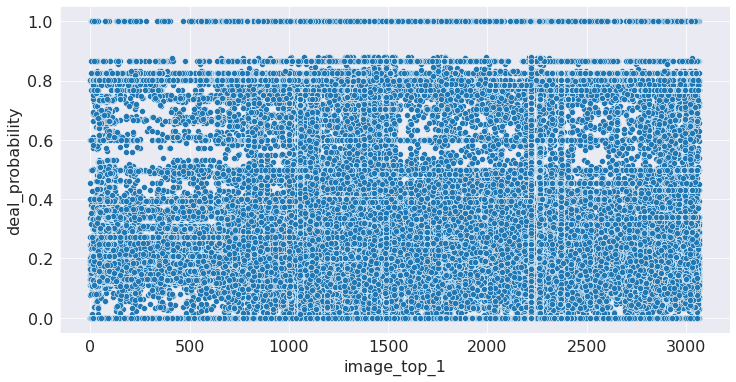

In [ ]:
sns.scatterplot(data=train_df, x='image_top_1', y='deal_probability');

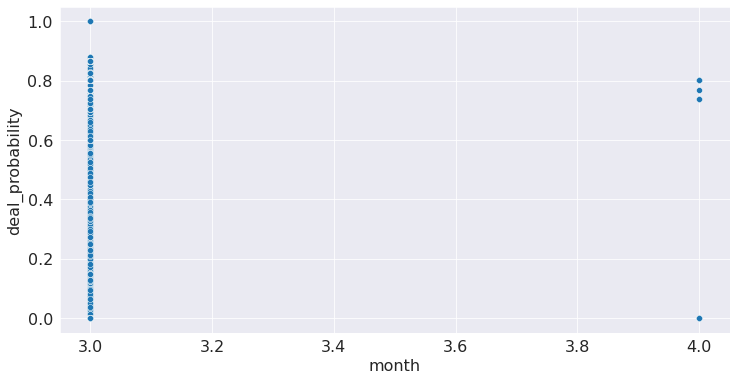

In [ ]:
sns.scatterplot(data=train_df, x='month', y='deal_probability');

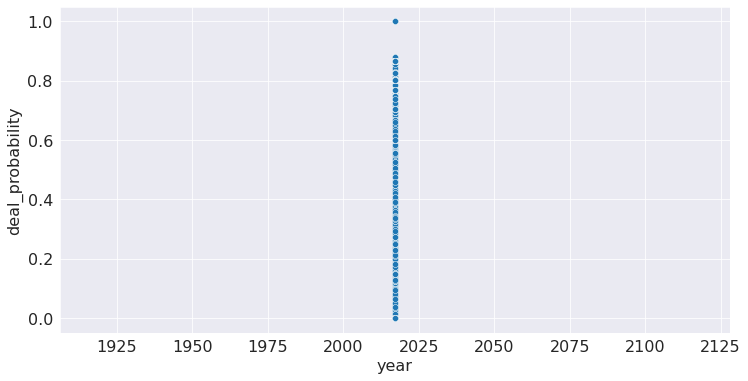

In [ ]:
sns.scatterplot(data=train_df, x='year', y='deal_probability')

In [ ]:
train_df.year.value_counts()

2017    1411044
Name: year, dtype: int64

Let us try to understand `user_type` with piechart

In [ ]:
fig = px.pie(train_df, 
             names="user_type", 
             title='User type distribution')
fig.show();

71.5% of online ads are from 'Private', 23% are from 'Company' and 5.5% are from 'Shop'.

Let us try to understand whole `train_df` with pandas profiling

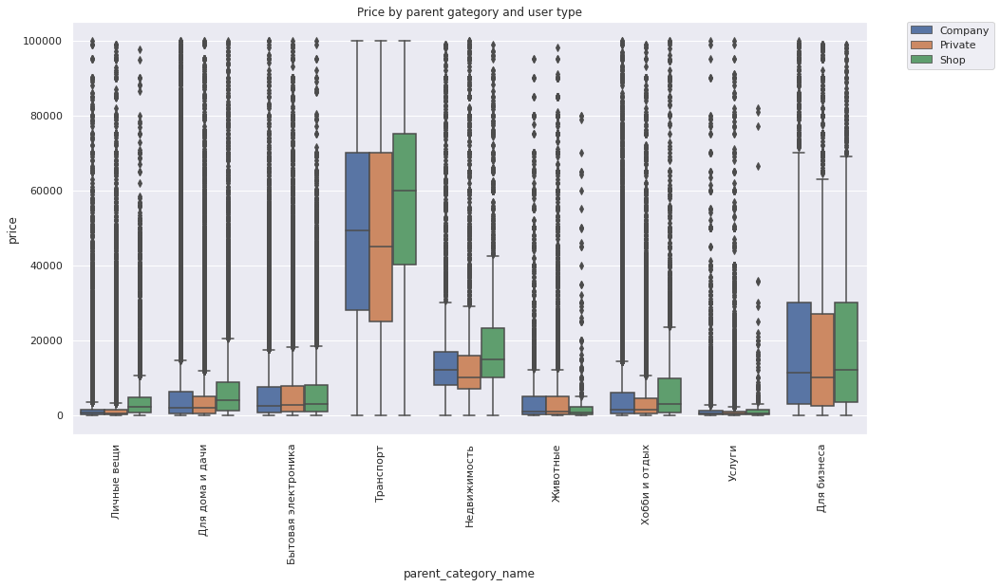

In [ ]:
sns.set(rc = {'figure.figsize': (15, 8)})

df_train_ = train_df[train_df.price.isnull() == False]
df_train_ = train_df.loc[train_df.price < 100000.0]

sns.boxplot(x = "parent_category_name",
           y = "price",
           hue = "user_type",
           data = df_train_)

plt.title("Price by parent gategory and user type")
plt.xticks(rotation = "vertical")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

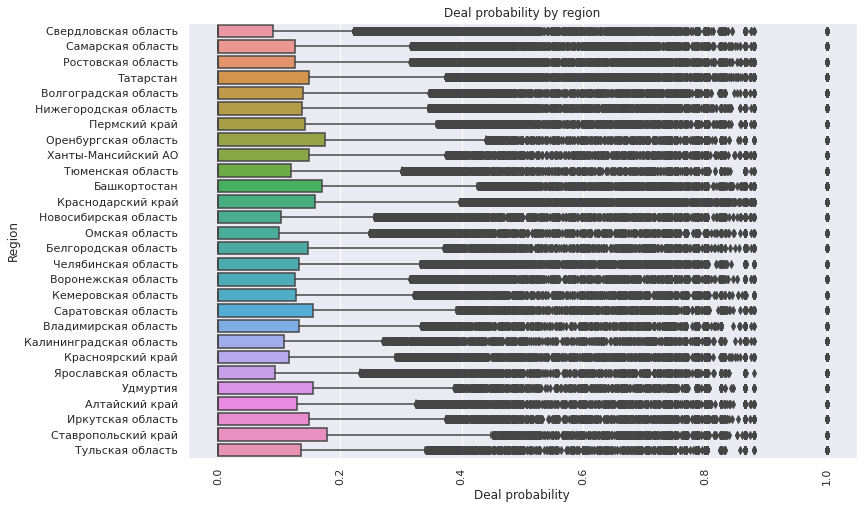

In [ ]:
plt.figure(figsize=(12,8))
sns.boxplot(y="region", x="deal_probability", data=train_df)
plt.xlabel('Deal probability', fontsize=12)
plt.ylabel('Region', fontsize=12)
plt.title("Deal probability by region")
plt.xticks(rotation='vertical')
plt.show()

# Defining the Input and Target Columns

In [ ]:
# Removing user_id column 
input_cols = ['region', 
              'city', 
              'parent_category_name', 
              'category_name',  
              'param_1',
              # 'param_2',
              # 'param_3',
              'title', 
              'price',
              'user_type',
              'image_top_1',
              'month',
              'dayofmonth', 
              'year',
              'dayofweek',
              'isweekend'
              ]
target_col = 'deal_probability'

In [ ]:
inputs_df, targets = train_df[input_cols].copy(), train_df[target_col].copy()

In [ ]:
# Identify numeric and categorical columns

numeric_cols = ['price', 'image_top_1']
categorical_cols = ['region', 'city', 'parent_category_name', 'category_name', 'param_1', 'title', 
                    'user_type', 'month', 'dayofmonth', 'dayofweek', 'isweekend']

In [ ]:
train_df.month.isna().sum()

0

In [ ]:
train_df.year.isna().sum()

0

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'


**Options for dealing with missing values in neuamarical columns**

1.Leave them as is, if they won't affect our analysis

2.Replace them with average

3.Remove the rows containing missing values.

4.Replace them with fixed values.

5.Use the values from other rows & columns to estimate the missing values to see what we can do about them

In [ ]:
train_df[numeric_cols].isna().sum()

price              0
image_top_1    85442
dtype: int64

In [ ]:
inputs_df[numeric_cols].isna().sum()

price              0
image_top_1    85442
dtype: int64

In [ ]:
inputs_df['price'].fillna(-99999, inplace=True)
test_df['price'].fillna(-99999, inplace=True)

In [ ]:
inputs_df['image_top_1'].fillna(-99999, inplace=True)
test_df['image_top_1'].fillna(-99999, inplace=True)

In [ ]:
inputs_df.drop(labels='year', axis=1, inplace=True)
test_df.drop(labels='year', axis=1, inplace=True)

In [ ]:
inputs_df[numeric_cols].isna().sum()

price          0
image_top_1    0
dtype: int64

In [ ]:
inputs_df[categorical_cols].isna().sum()

region                      0
city                        0
parent_category_name        0
category_name               0
param_1                 56830
title                       0
user_type                   0
month                       0
dayofmonth                  0
dayofweek                   0
isweekend                   0
dtype: int64

### Feature Selection
The input variables that we give to our machine learning models are called features. Each column in our dataset constitutes a feature. To train an optimal model, we need to make sure that we use only the essential features.

####Why feature Selection
Machine learning models follow a simple rule: whatever goes in, comes out. If we put garbage into our model, we can expect the output to be garbage too. In this case, garbage refers to noise in our data.

To train a model, we collect enormous quantities of data to help the machine learn better.Feature Selection is the method of reducing the input variable to your model by using only relevant data and getting rid of noise in data.

It is the process of automatically choosing relevant features for your machine learning model based on the type of problem you are trying to solve. We do this by including or excluding important features without changing them. It helps in cutting down the noise in our data and reducing the size of our input data.

In [ ]:
inputs_df['param_1'].fillna('Missing', inplace=True)


Imputing the missing value with the value of 'Missing' in the test data as well.

In [ ]:
test_df['param_1'].fillna('Missing', inplace=True)


Since the input_df do not have the `description` and `user_id` columns, we'll be deleting the same from the test data as well. 

In [ ]:
test_df.drop(labels='description', axis=1, inplace=True)

In [ ]:
test_df.drop(labels='user_id', axis=1, inplace=True)

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

# Model Selection

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor, plot_tree, export_text
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import Ridge
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold
from sklearn.preprocessing import MinMaxScaler, LabelEncoder

import sklearn

from matplotlib import pyplot

## Step1: Imputation Technique
Impute Numeric Variables with mean of the variable

In [ ]:
from sklearn.impute import KNNImputer
imputer = KNNImputer(weights='uniform').fit(inputs_df[numeric_cols])

inputs_df[numeric_cols] = imputer.transform(inputs_df[numeric_cols])
test_df[numeric_cols] = imputer.transform(test_df[numeric_cols])

In [ ]:
inputs_df[numeric_cols].isna().sum()

price          0
image_top_1    0
dtype: int64

In [ ]:
test_df[numeric_cols].isna().sum()

price          0
image_top_1    0
dtype: int64


Let us check for null categorical coulumn values in input and test data

In [ ]:
inputs_df[categorical_cols].isna().sum()

region                  0
city                    0
parent_category_name    0
category_name           0
param_1                 0
title                   0
user_type               0
month                   0
dayofmonth              0
dayofweek               0
isweekend               0
dtype: int64

In [ ]:
test_df[categorical_cols].isna().sum()

region                  0
city                    0
parent_category_name    0
category_name           0
param_1                 0
title                   0
user_type               0
month                   0
dayofmonth              0
dayofweek               0
isweekend               0
dtype: int64

So we can say that there are no null values

## Step 2. Scale Data With Normalization

Normalization is a scaling technique in Machine Learning applied during data preparation to change the values of numeric columns in the dataset to use a common scale. It is not necessary for all datasets in a model. It is required only when features of machine learning models have different ranges.

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler().fit(inputs_df[numeric_cols])
inputs_df[numeric_cols] = scaler.transform(inputs_df[numeric_cols])
test_df[numeric_cols] = scaler.transform(test_df[numeric_cols])

## Step 3. Transform Categories With Encoding

In [ ]:
inputs_df.head()

,region,city,parent_category_name,category_name,param_1,title,price,user_type,image_top_1,month,dayofmonth,dayofweek,isweekend
item_id,,,,,,,,,,,,,
b912c3c6a6ad,Свердловская область,Екатеринбург,Личные вещи,Товары для детей и игрушки,Постельные принадлежности,Кокоби(кокон для сна),9.500e-06,Private,0.980,3,28,1,0
2dac0150717d,Самарская область,Самара,Для дома и дачи,Мебель и интерьер,Другое,Стойка для Одежды,7.140e-05,Private,0.977,3,26,6,1
ba83aefab5dc,Ростовская область,Ростов-на-Дону,Бытовая электроника,Аудио и видео,"Видео, DVD и Blu-ray плееры",Philips bluray,9.521e-05,Private,1.000,3,20,0,0
02996f1dd2ea,Татарстан,Набережные Челны,Личные вещи,Товары для детей и игрушки,Автомобильные кресла,Автокресло,5.236e-05,Company,0.978,3,25,5,1
7c90be56d2ab,Волгоградская область,Волгоград,Транспорт,Автомобили,С пробегом,"ВАЗ 2110, 2003",9.524e-04,Private,0.992,3,16,3,0


In [ ]:
# Encoding labels of multiple Categorical columns 
from sklearn.preprocessing import LabelEncoder

inputs_df[categorical_cols] = inputs_df[categorical_cols].apply(LabelEncoder().fit_transform)
inputs_df.head()

,region,city,parent_category_name,category_name,param_1,title,price,user_type,image_top_1,month,dayofmonth,dayofweek,isweekend
item_id,,,,,,,,,,,,,
b912c3c6a6ad,19,458,4,42,244,283998,9.500e-06,1,0.980,0,17,1,0
2dac0150717d,17,1291,2,22,121,636823,7.140e-05,1,0.977,0,15,6,1
ba83aefab5dc,16,1267,0,2,83,77998,9.521e-05,1,1.000,0,9,0,0
02996f1dd2ea,21,933,4,42,38,107193,5.236e-05,0,0.978,0,14,5,1
7c90be56d2ab,4,316,6,0,273,156231,9.524e-04,1,0.992,0,5,3,0


In [ ]:
inputs_df.dtypes

region                    int64
city                      int64
parent_category_name      int64
category_name             int64
param_1                   int64
title                     int64
price                   float64
user_type                 int64
image_top_1             float64
month                     int64
dayofmonth                int64
dayofweek                 int64
isweekend                 int64
dtype: object

In [ ]:
test_df[categorical_cols] = test_df[categorical_cols].apply(LabelEncoder().fit_transform)
test_df.head()

,region,city,parent_category_name,category_name,param_1,title,price,user_type,image_top_1,month,dayofmonth,dayofweek,isweekend
item_id,,,,,,,,,,,,,
6544e41a8817,4,306,4,10,108,181528,-2.381e-03,1,0.990,0,6,1,0
65b9484d670f,19,933,8,5,117,210002,7.140e-05,1,0.000,0,4,6,1
8bab230b2ecd,12,147,0,2,310,18020,3.571e-04,1,0.999,0,5,0,0
8e348601fefc,18,1238,2,4,106,75062,1.071e-04,1,0.000,0,5,0,0
8bd2fe400b89,14,236,4,42,100,120030,1.166e-04,1,0.980,0,3,5,1


In [ ]:
test_df.dtypes

region                    int64
city                      int64
parent_category_name      int64
category_name             int64
param_1                   int64
title                     int64
price                   float64
user_type                 int64
image_top_1             float64
month                     int64
dayofmonth                int64
dayofweek                 int64
isweekend                 int64
dtype: object

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

## Splitting the training, validtaion inputs and targets
The train-test split procedure is used to estimate the performance of machine learning algorithms when they are used to make predictions on data not used to train the model.

In [ ]:
# Create training and validation sets
train_inputs, val_inputs, train_targets, val_targets = train_test_split(
    inputs_df, targets, test_size=0.25, random_state=42)

In [ ]:
X_train = train_inputs[numeric_cols + categorical_cols]
X_val = val_inputs[numeric_cols + categorical_cols]
X_test = test_df[numeric_cols + categorical_cols]

In [ ]:
import gc
gc.collect()

17832

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

### Baseline Model

In [ ]:
def return_mean(inputs):
    return np.full(len(inputs), train_df.deal_probability.mean())

In [ ]:
train_preds = return_mean(X_train)

In [ ]:
mean_squared_error(return_mean(X_val), val_targets, squared=False)

0.2575588707414018

 RMSE value lower than **0.2608495232930128** is desired

In [ ]:
len(inputs_df)

1411044

In [ ]:
from xgboost import XGBRegressor
import lightgbm as lgb

In [ ]:
models = []

models.append(DecisionTreeRegressor())
models.append(Lasso())
models.append(ElasticNet())
models.append(Ridge())
models.append(KNeighborsRegressor())
models.append(XGBRegressor())
models.append(RandomForestRegressor())

In [ ]:
# Evaluate models 
model_names=['DecisionTreeRegressor',
             'Lasso',
             'ElasticNet',
             'Ridge',
             'KNeighborsRegressor',
             'XGBRegressor',
             'RandomForestRegressor']             
rmse = []
eval_rmse={}
for model in range(len(models)):
  reg_model = models[model]
  re = reg_model.fit(X_train, train_targets)
  train_preds = re.predict(X_train)
  rmse.append(mean_squared_error(train_preds, train_targets, squared=False))
  
eval_rmse = {'Modelling Algorithm': model_names, 'RMSE': rmse}
print(eval_rmse)

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning:

Ill-conditioned matrix (rcond=8.08059e-17): result may not be accurate.



[07:03:41] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
{'Modelling Algorithm': ['DecisionTreeRegressor', 'Lasso', 'ElasticNet', 'Ridge', 'KNeighborsRegressor', 'XGBRegressor', 'RandomForestRegressor'], 'RMSE': [0.00963839191915445, 0.2562735474628737, 0.2560760959484465, 0.25531349343520826, 0.2080486897964273, 0.2358763999180621, 0.0864031749230054]}


In [ ]:
pd.set_option("display.precision", 8)
rmse_table = pd.DataFrame(eval_rmse)
rmse_table = rmse_table.sort_values(by='RMSE', ascending=False)
rmse_table

,Modelling Algorithm,RMSE
1,Lasso,0.25627355
2,ElasticNet,0.25607610
3,Ridge,0.25531349
5,XGBRegressor,0.23587640
4,KNeighborsRegressor,0.20804869
6,RandomForestRegressor,0.08640317
0,DecisionTreeRegressor,0.00963839


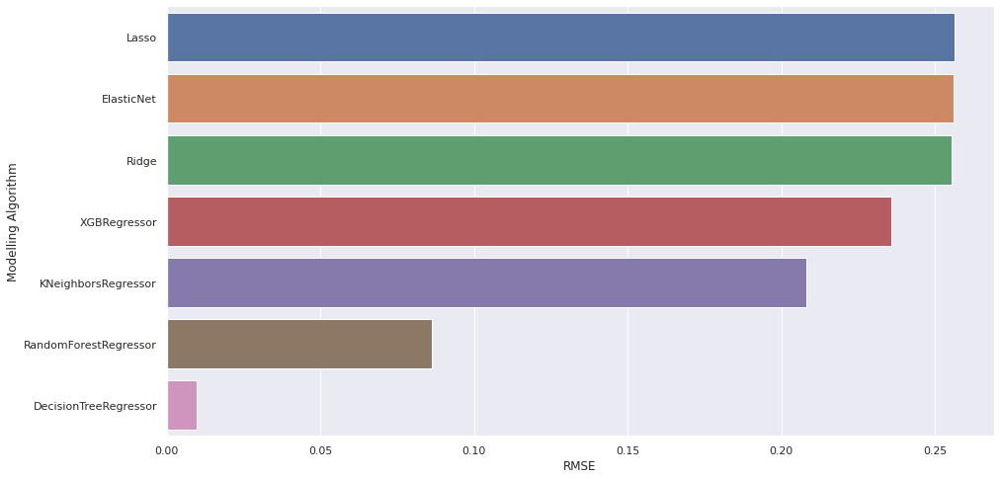

In [ ]:
# Barplot to identify the best performing modelling algorithm
sns.barplot(data=rmse_table, x='RMSE', y='Modelling Algorithm');

# Try Different Models

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

In [ ]:
def calculate_rmse(model):
    # Fit the model
    model.fit(X_train, train_targets)
    
    # Generate predictions
    train_preds = model.predict(X_train)
    val_preds = model.predict(X_val)
    
    # Compute RMSE
    train_rmse = mean_squared_error(train_targets, train_preds, squared=False)
    val_rmse = mean_squared_error(val_targets, val_preds, squared=False)
    return train_rmse, val_rmse

## Linear models

The term linear model implies that the model is specified as a linear combination of features. Based on training data, the learning process computes one weight for each feature to form a model that can predict or estimate the target value.

1.Linear regression

In [ ]:
train_rmse, val_rmse = calculate_rmse(LinearRegression())
print('LinearRegression: \n Train RMSE: {}, Validation RMSE: {}'.format(train_rmse, val_rmse))

LinearRegression: 
 Train RMSE: 0.2553134440717648, Validation RMSE: 0.2552148602900328


**2. Ridge Regression**

Ridge regression is a model tuning method that is used to analyse any data that suffers from multicollinearity. This method performs L2 regularization. When the issue of multicollinearity occurs, least-squares are unbiased, and variances are large, this results in predicted values being far away from the actual values. 

In [ ]:
from sklearn.model_selection import GridSearchCV

# Instanciate a Ridge Model
ridge = Ridge()

In [ ]:
# Set list of parameters to test
params = { 'alpha': [0.001, 0.001, 0.01, 1]}

# Grid Search
grid = GridSearchCV(ridge,
                    param_grid=params,
                    scoring=['neg_mean_squared_error'],
                    refit='neg_mean_squared_error',
                    verbose=1, 
                    cv=5)

In [ ]:
# Fit the grid search
grid.fit(X_train, train_targets)
grid.cv_results_

Fitting 5 folds for each of 4 candidates, totalling 20 fits


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning:

Ill-conditioned matrix (rcond=5.05359e-17): result may not be accurate.

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning:

Ill-conditioned matrix (rcond=5.05226e-17): result may not be accurate.

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning:

Ill-conditioned matrix (rcond=7.58017e-17): result may not be accurate.

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning:

Ill-conditioned matrix (rcond=5.05075e-17): result may not be accurate.

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning:

Ill-conditioned matrix (rcond=7.57862e-17): result may not be accurate.

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning:

Ill-conditioned matrix (rcond=5.05359e-17): result may not be accurate.

/usr/local/lib/p

{'mean_fit_time': array([0.26221771, 0.25270252, 0.25400481, 0.25479212]),
 'mean_score_time': array([0.06556516, 0.06595063, 0.06497631, 0.06496601]),
 'mean_test_neg_mean_squared_error': array([-0.06518696, -0.06518696, -0.06518696, -0.0651868 ]),
 'param_alpha': masked_array(data=[0.001, 0.001, 0.01, 1],
              mask=[False, False, False, False],
        fill_value='?',
             dtype=object),
 'params': [{'alpha': 0.001}, {'alpha': 0.001}, {'alpha': 0.01}, {'alpha': 1}],
 'rank_test_neg_mean_squared_error': array([3, 3, 2, 1], dtype=int32),
 'split0_test_neg_mean_squared_error': array([-0.06541148, -0.06541148, -0.06541148, -0.06541185]),
 'split1_test_neg_mean_squared_error': array([-0.06449245, -0.06449245, -0.06449245, -0.06449275]),
 'split2_test_neg_mean_squared_error': array([-0.06523855, -0.06523855, -0.06523855, -0.06523853]),
 'split3_test_neg_mean_squared_error': array([-0.06558812, -0.06558812, -0.0655881 , -0.06558666]),
 'split4_test_neg_mean_squared_error': 

In [ ]:
# Check the best estimator
grid.best_estimator_

Ridge(alpha=1)

In [ ]:
# Use the trained best model
ridge = Ridge(alpha=1, copy_X=True, fit_intercept=True, max_iter=None, normalize=False,
      random_state=None, solver='auto', tol=0.001)
print('Ridge: \n Train RMSE: {}, Validation RMSE: {}'.format(train_rmse, val_rmse))

Ridge: 
 Train RMSE: 0.2553134440717648, Validation RMSE: 0.2552148602900328


In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

**3. Lasso Regression**

Lasso regression is a regularization technique. It is used over regression methods for a more accurate prediction. This model uses shrinkage. Shrinkage is where data values are shrunk towards a central point as the mean. The lasso procedure encourages simple, sparse models (i.e. models with fewer parameters). This particular type of regression is well-suited for models showing high levels of multicollinearity or when you want to automate certain parts of model selection, like variable selection/parameter elimination.

Define cross validation 

In [ ]:
#define cross-validation method to use
cv = KFold(n_splits=10, random_state=42, shuffle=True)

In [ ]:
from sklearn.model_selection import RepeatedKFold
from sklearn.linear_model import LassoCV

cva = RepeatedKFold(n_splits=10, n_repeats = 3, random_state=42)
lasso = LassoCV(alphas=np.arange(0.001,1,.01), cv=cva,n_jobs=-1)

calculate_rmse(lasso)
print('LassoCV: \n Train RMSE: {}, Validation RMSE: {}'.format(train_rmse, val_rmse))

LassoCV: 
 Train RMSE: 0.2553134440717648, Validation RMSE: 0.2552148602900328


**4. Elasticnet Regression**

Elastic net is a popular type of regularized linear regression that combines two popular penalties, specifically the L1 and L2 penalty functions.
Elastic Net is an extension of linear regression that adds regularization penalties to the loss function during training.

In [ ]:
from sklearn.linear_model import ElasticNetCV

cva = RepeatedKFold(n_splits=10, n_repeats = 3, random_state=42)


elastic = ElasticNetCV(alphas=np.arange(0.001,1,.01), cv=cva,n_jobs=-1)
calculate_rmse(elastic)
print('ElasticNetCV: \n Train RMSE: {}, Validation RMSE: {}'.format(train_rmse, val_rmse))

ElasticNetCV: 
 Train RMSE: 0.2553134440717648, Validation RMSE: 0.2552148602900328


In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

In [ ]:
import gc
gc.collect()

174

# Tree Based Models
Tree-based classification models are a type of supervised machine learning algorithm that uses a series of conditional statements to partition training data into subsets. Each successive split adds some complexity to the model, which can be used to make predictions. The end result model can be visualized as a roadmap of logical tests that describes the data set. Decision trees are popular for small-to-medium-sized data sets because they are easy to implement and even easier to interpret

1. Fit & Transform the Decision Tree

In [ ]:
tree = DecisionTreeRegressor(random_state=42)
calculate_rmse(tree)
print('DecisionTreeRegressor: \n Train RMSE: {}, Validation RMSE: {}'.format(train_rmse, val_rmse))

DecisionTreeRegressor: 
 Train RMSE: 0.2553134440717648, Validation RMSE: 0.2552148602900328


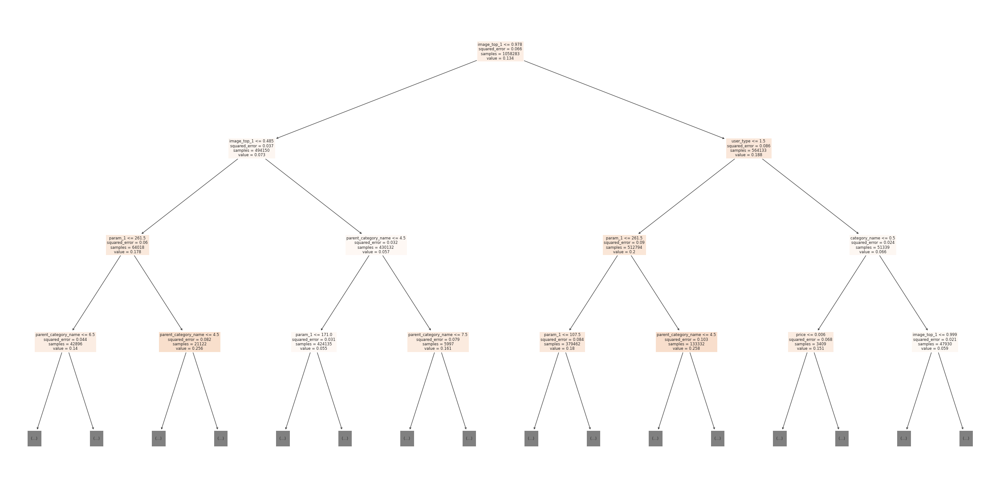

In [ ]:
plt.figure(figsize=(40, 20))
plot_tree(tree, max_depth=3, filled=True, feature_names=numeric_cols + categorical_cols);

## Random forest regressor

Every decision tree has high variance, but when we combine all of them together in parallel then the resultant variance is low as each decision tree gets perfectly trained on that particular sample data, and hence the output doesn’t depend on one decision tree but on multiple decision trees. In the case of a classification problem, the final output is taken by using the majority voting classifier.

In [ ]:
rf = RandomForestRegressor(random_state=42, n_jobs=-1)
calculate_rmse(rf)
print('RandomForestRegressor: \n Train RMSE: {}, Validation RMSE: {}'.format(train_rmse, val_rmse))

RandomForestRegressor: 
 Train RMSE: 0.2553134440717648, Validation RMSE: 0.2552148602900328


2. Feature Importance

In [ ]:
rf.feature_importances_

array([1.38269424e-01, 1.67996496e-01, 9.12790488e-02, 1.21686879e-01,
       2.58105490e-02, 2.06856003e-02, 5.49479682e-02, 2.13990081e-01,
       2.78251436e-02, 2.31548369e-06, 7.83736281e-02, 5.12832078e-02,
       7.84965841e-03])

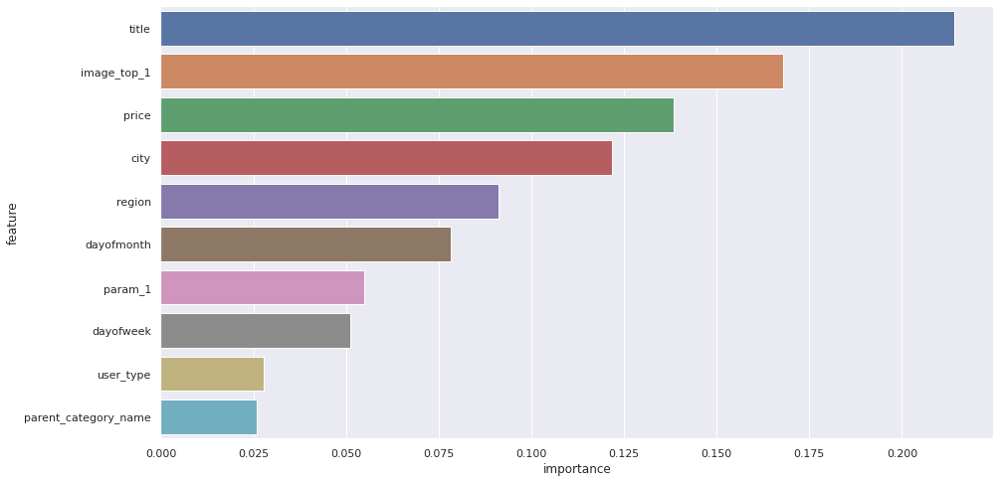

In [ ]:
importance_df = pd.DataFrame({ 
    'feature': numeric_cols+categorical_cols, 
    'importance': rf.feature_importances_
}).sort_values('importance', ascending=False)
sns.barplot(data=importance_df.head(10), x='importance', y='feature');

By looking at above graph we can say that
*   `title` is the most important feature
*   `image_top_1` is the second most important feature later comes
     `price`, `city`, `region` and so on.



#### Hyperparameter Tuning and Regularization — Random Forest Regressor

1. Helper Function to find the best hyperparameters for Random Forest Regressor

In [ ]:
def test_params_rf(**params):
    model = RandomForestRegressor(random_state=42, n_jobs=-1, **params).fit(train_inputs, train_targets)
    train_rmse = mean_squared_error(model.predict(train_inputs), train_targets, squared=False)
    val_rmse = mean_squared_error(model.predict(val_inputs), val_targets, squared=False)
    return train_rmse, val_rmse

2. Evaluate different hyperparameters

In [ ]:
test_params_rf(n_estimators=10, max_depth=20)

(0.18209389904606418, 0.22952660244352469)

In [ ]:
test_params_rf(n_estimators=20)

(0.09354051732442781, 0.23445584521205937)

In [ ]:
test_params_rf(n_estimators=50)

(0.08833020504687758, 0.23113866688105592)

In [ ]:
gc.collect()

6743

In [ ]:
def test_param_and_plot_rf(param_name, param_values):
    train_errors, val_errors = [], [] 
    for value in param_values:
        params = {param_name: value}
        train_rmse, val_rmse = test_params_rf(**params)
        train_errors.append(train_rmse)
        val_errors.append(val_rmse)
    plt.figure(figsize=(10,6))
    plt.title('Overfitting curve: ' + param_name)
    plt.plot(param_values, train_errors, 'b-o')
    plt.plot(param_values, val_errors, 'r-o')
    plt.xlabel(param_name)
    plt.ylabel('RMSE')
    plt.legend(['Training', 'Validation'])

Figuring out the best value `max_depth`

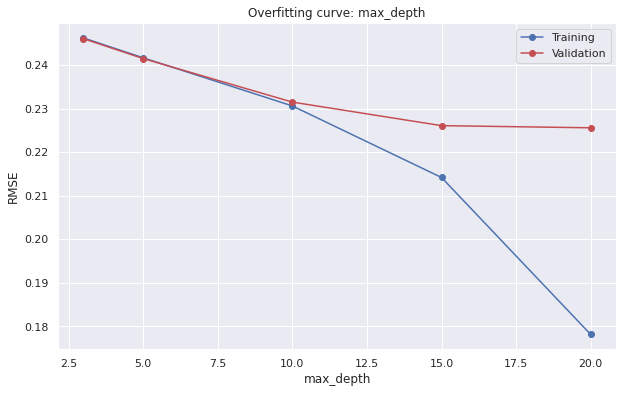

In [ ]:
test_param_and_plot_rf('max_depth', [3, 5, 10, 15, 20])

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

It seems max_depth of 7.2 is a good value. 

In [ ]:
test_params_rf(n_estimators=30, max_depth=7.2, min_samples_leaf=4, max_features=0.4)

(0.23690679724596098, 0.2368145485065812)

In [ ]:
test_params_rf(n_estimators=50, 
            max_depth=7.2, 
            min_samples_leaf=4, 
            min_samples_split=3,
            max_features='log2', 
            max_leaf_nodes=128, 
            min_impurity_decrease=1e-6, 
            max_samples=0.9
           )

(0.23748678554151903, 0.23732611681267504)

In [ ]:
test_params_rf(n_estimators=50, 
            max_depth=7.2, 
            min_samples_leaf=4, 
            min_samples_split=3,
            max_leaf_nodes=128, 
            min_impurity_decrease=1e-6, 
            max_samples=0.9
           )

(0.23707864599645584, 0.2370471998698745)

In [ ]:
test_params_rf(n_estimators=50, 
            max_depth=15, 
            min_samples_leaf=4 
           )

(0.21613579668232344, 0.22606994619082585)

In [ ]:
test_params_rf(n_estimators=30, 
            max_depth=15, 
            min_samples_leaf=4 
           )

(0.2162219831425841, 0.22617817592523168)

4.Training the best Model

In [ ]:
%%time

tuned_rf1 = RandomForestRegressor(n_estimators=30, 
            max_depth=15)
calculate_rmse(tuned_rf1)
print('RandomFRegressor: \n Train RMSE: {}, Validation RMSE: {}'.format(train_rmse, val_rmse))

RandomFRegressor: 
 Train RMSE: 0.2553134440717648, Validation RMSE: 0.2552148602900328
CPU times: user 2min 25s, sys: 127 ms, total: 2min 25s
Wall time: 2min 25s


In [ ]:
tuned_rf2 = RandomForestRegressor(n_estimators=50, 
            max_depth=7.2, 
            min_samples_leaf=4, 
            min_samples_split=3,
            max_features='log2', 
            max_leaf_nodes=128, 
            min_impurity_decrease=1e-6, 
            max_samples=0.9)
calculate_rmse(tuned_rf2)
print('RandomForestRegressor: \n Train RMSE: {}, Validation RMSE: {}'.format(train_rmse, val_rmse))

RandomForestRegressor: 
 Train RMSE: 0.2553134440717648, Validation RMSE: 0.2552148602900328


In [ ]:
tuned_rf2 = RandomForestRegressor(n_estimators=50, 
            max_depth=7.2, 
            min_samples_leaf=4, 
            min_samples_split=3,
            max_features='log2', 
            max_leaf_nodes=128, 
            min_impurity_decrease=1e-6, 
            max_samples=0.9)
calculate_rmse(tuned_rf2)
print('RandomForestRegressor: \n Train RMSE: {}, Validation RMSE: {}'.format(train_rmse, val_rmse))

RandomForestRegressor: 
 Train RMSE: 0.2553134440717648, Validation RMSE: 0.2552148602900328


In [ ]:
tuned_rf1_importance_df = pd.DataFrame({
    'feature': train_inputs.columns,
    'importance': tuned_rf1.feature_importances_
}).sort_values('importance', ascending=False)
tuned_rf1_importance_df

,feature,importance
1,city,0.31412143
6,price,0.14126485
0,region,0.12988955
7,user_type,0.11062491
4,param_1,0.07949045
8,image_top_1,0.05775669
5,title,0.05185411
3,category_name,0.04238999
2,parent_category_name,0.03225391
10,dayofmonth,0.02416806


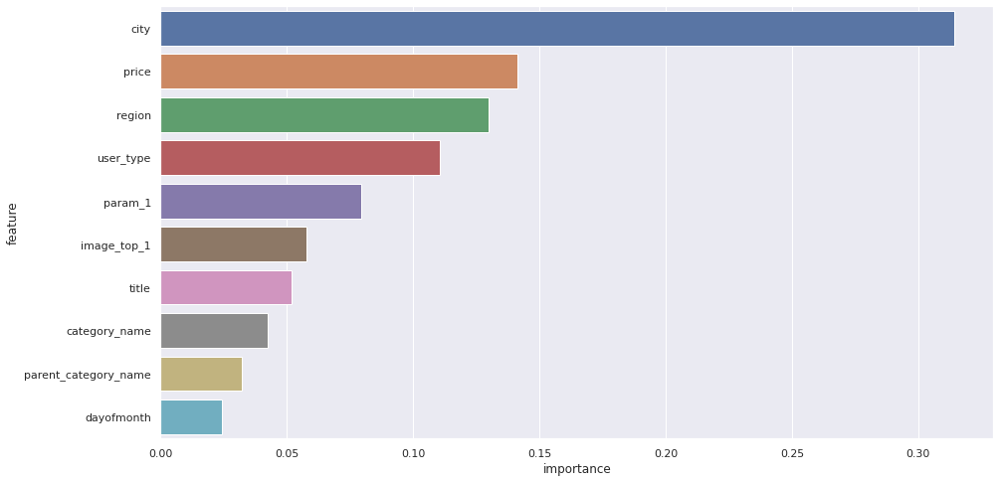

In [ ]:
sns.barplot(data=tuned_rf1_importance_df.head(10), x='importance', y='feature');

## Gradient Boosting
Using XGBRegressor to train GBM

In [ ]:
def test_params_xgb(**params):
    model = XGBRegressor(random_state=42, n_jobs=-1, **params).fit(train_inputs, train_targets)
    train_rmse = mean_squared_error(model.predict(train_inputs), train_targets, squared=False)
    val_rmse = mean_squared_error(model.predict(val_inputs), val_targets, squared=False)
    return train_rmse, val_rmse

In [ ]:

from xgboost import XGBRegressor

xgb = XGBRegressor(random_state=42, n_jobs=-1)

Validating best parameters

In [ ]:
test_params_xgb(n_estimators=10)

[08:17:58] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


(0.27718293623122764, 0.27693776951051335)

In [ ]:
test_params_xgb(n_estimators=25)

[08:18:19] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


(0.24231436814822796, 0.2420936468760744)

In [ ]:
test_params_xgb(n_estimators=50)

[08:18:45] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


(0.23831561297895926, 0.23809726119866215)

In [ ]:
test_params_xgb(n_estimators=100)

[08:19:26] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


(0.2358763999180621, 0.23565521710293263)

In [ ]:
def test_param_and_plot_xgb(param_name, param_values):
    train_errors, val_errors = [], [] 
    for value in param_values:
        params = {param_name: value}
        train_rmse, val_rmse = test_params_xgb(**params)
        train_errors.append(train_rmse)
        val_errors.append(val_rmse)
    plt.figure(figsize=(10,6))
    plt.title('Overfitting curve: ' + param_name)
    plt.plot(param_values, train_errors, 'b-o')
    plt.plot(param_values, val_errors, 'r-o')
    plt.xlabel(param_name)
    plt.ylabel('RMSE')
    plt.legend(['Training', 'Validation'])

[08:34:41] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[08:35:47] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[08:37:38] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[08:41:52] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[08:48:46] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


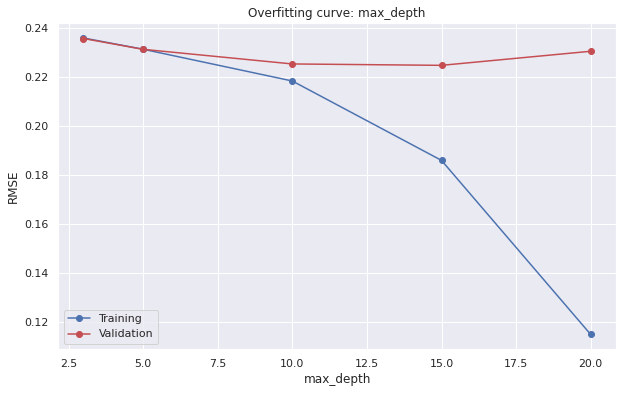

In [ ]:
test_param_and_plot_xgb('max_depth', [3, 5, 10, 15, 20])

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

The factor `learning_rate` has to be applied to the prediction of each tree

In [ ]:
test_params_xgb(n_estimators=5, learning_rate=0.01)

[09:02:04] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


(0.43239104698097375, 0.4322495524332633)

In [ ]:
test_params_xgb(n_estimators=5, learning_rate=0.3)

[09:02:12] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


(0.2508116845886116, 0.25057086468250434)

In [ ]:
test_params_xgb(n_estimators=5, learning_rate=0.9)

[09:02:21] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


(0.2395176768257809, 0.23932632475828378)

In [ ]:
test_params_xgb(booster='gbtree')

[09:02:29] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


(0.2358763999180621, 0.23565521710293263)

In [ ]:
xgb = XGBRegressor(n_jobs=-1, random_state=42, n_estimators=5, 
                     learning_rate=0.01, max_depth=5)
calculate_rmse(xgb)
print('XGBRegressor: \n Train RMSE: {}, Validation RMSE: {}'.format(train_rmse, val_rmse))

[09:06:24] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
XGBRegressor: 
 Train RMSE: 0.2553134440717648, Validation RMSE: 0.2552148602900328


Visualizing the trees

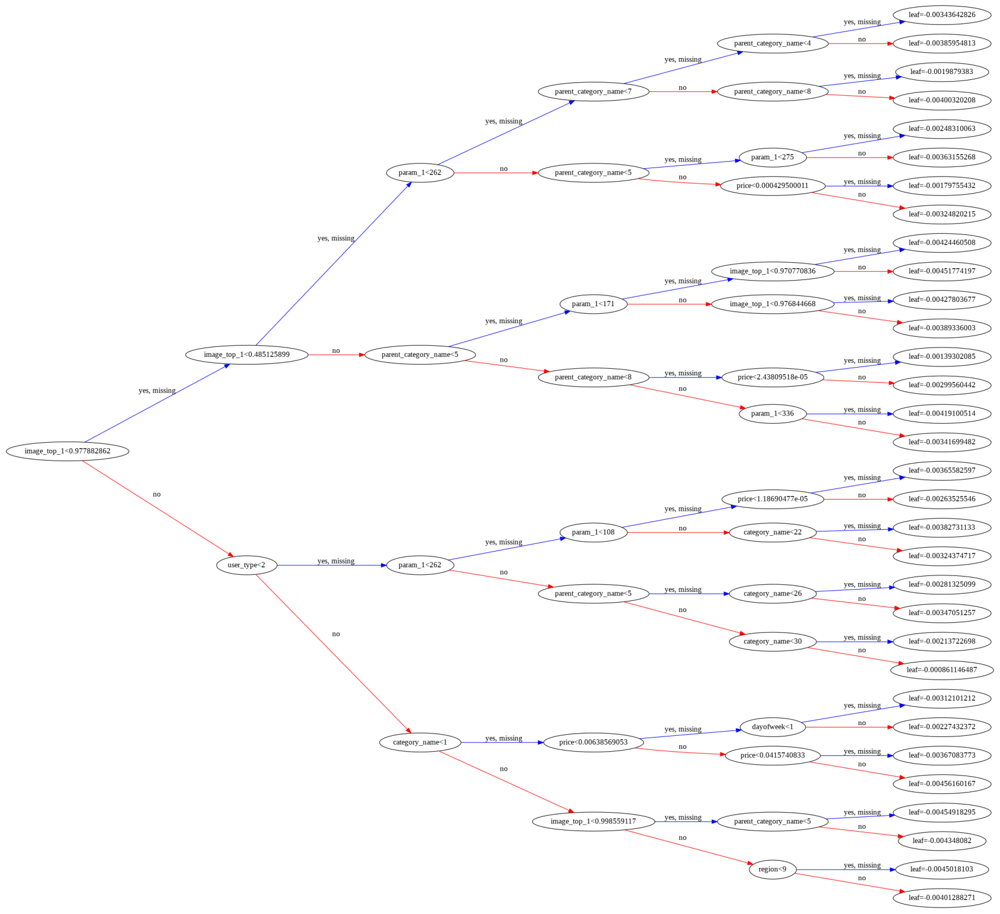

In [ ]:
from matplotlib.pylab import rcParams
from xgboost import plot_tree

%matplotlib inline

rcParams['figure.figsize'] = 30,30
plot_tree(xgb, rankdir='LR');

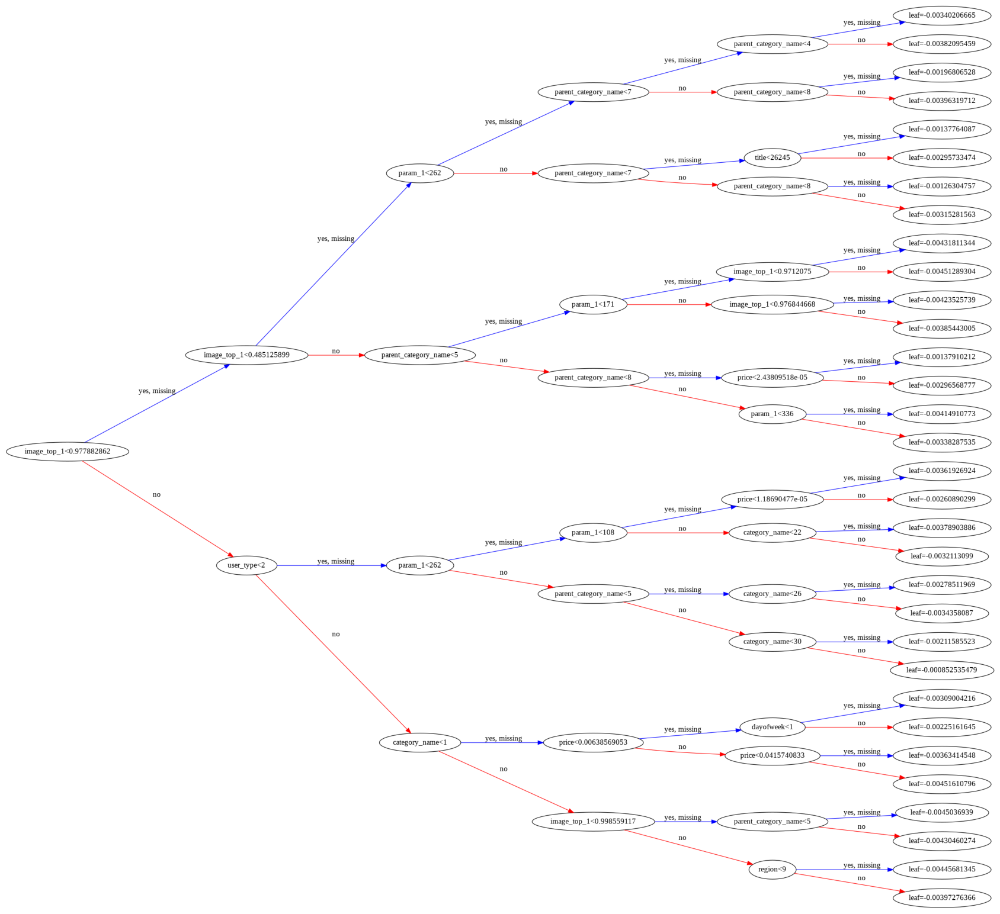

In [ ]:
plot_tree(xgb, rankdir='LR', num_trees=1);

In [ ]:
#feature importance score
xgb_importance_df = pd.DataFrame({
    'feature': train_inputs.columns,
    'importance': xgb.feature_importances_
}).sort_values('importance', ascending=False)
xgb_importance_df.head(10)

,feature,importance
1,city,0.38171512
8,image_top_1,0.36893722
6,price,0.10372548
5,title,0.04881129
4,param_1,0.04748665
0,region,0.03085275
7,user_type,0.01677596
2,parent_category_name,0.00137942
11,dayofweek,0.00031607
3,category_name,0.00000000


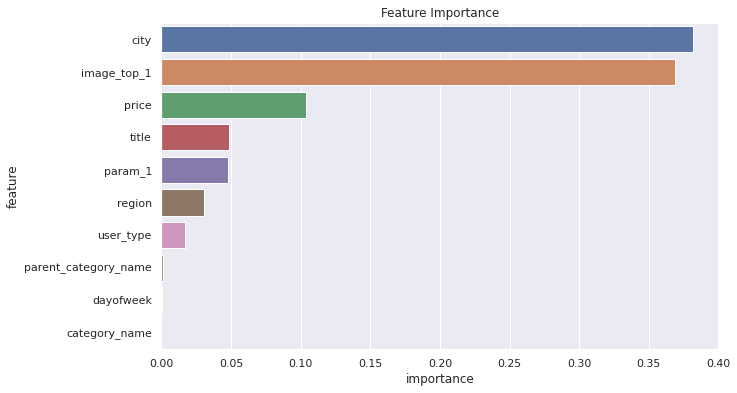

In [ ]:
plt.figure(figsize=(10,6))
plt.title('Feature Importance')
sns.barplot(data=xgb_importance_df.head(10), x='importance', y='feature');

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

## Looking at induvidual prediction

In [ ]:
def predict_input(model, single_input):
    input_df = pd.DataFrame([single_input])
    input_df[numeric_cols] = imputer.transform(input_df[numeric_cols])
    input_df[numeric_cols] = scaler.transform(input_df[numeric_cols])
    input_df[categorical_cols] = input_df[categorical_cols].apply(LabelEncoder().fit_transform)
    X_input = input_df[numeric_cols + categorical_cols]
    pred = model.predict(X_input)[0]
    return pred 

In [ ]:
sample_input = {
    'region': 4,
    'city': 9,
    'parent_category_name': 10,
    'category_name': 22,
    'param_1': 12,
    'price': 6780.0,
    'title': 17,
    'user_type': 99,
    'image_top_1': 88,
    'month': 3,
    'dayofmonth': 28,
    'dayofweek': 4,
    'isweekend': 5}
 											
sample_input

{'category_name': 22,
 'city': 9,
 'dayofmonth': 28,
 'dayofweek': 4,
 'image_top_1': 88,
 'isweekend': 5,
 'month': 3,
 'param_1': 12,
 'parent_category_name': 10,
 'price': 6780.0,
 'region': 4,
 'title': 17,
 'user_type': 99}

In [ ]:
predicated_deal_prob = predict_input(tuned_rf1, sample_input)

In [ ]:
print('The predicted probability for Online ad demand : {}'.format(predicated_deal_prob))

The predicted probability for Online ad demand : 0.3188170949465741


In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

# Making Submission on kaggle

In [ ]:
test_preds = tuned_rf1.predict(X_test)
len(test_preds)

508438

In [ ]:
print(test_preds)

[0.09292245 0.09961038 0.32586156 ... 0.03203332 0.25938857 0.06894981]


In [ ]:
submission_df = pd.read_csv('sample_submission.csv')

In [ ]:
submission_df

,item_id,deal_probability
0,6544e41a8817,0.5
1,65b9484d670f,0.5
2,8bab230b2ecd,0.5
3,8e348601fefc,0.5
4,8bd2fe400b89,0.5
...,...,...
508433,9f2200aed300,0.5
508434,70813f518de4,0.5
508435,a22a2eeb5dd2,0.5
508436,ed7fbb0733c1,0.5


In [ ]:
submission_df.item_id.duplicated().any()

False

In [ ]:
submission_df['deal_probability'] = test_preds.astype('float')

In [ ]:
submission_df.fillna(0, inplace=True)

In [ ]:
submission_df.isna().sum()

item_id             0
deal_probability    0
dtype: int64

In [ ]:
submission_df.to_csv('submission.csv', index=False, header=1)

In [ ]:
!head submission.csv

item_id,deal_probability
6544e41a8817,0.09292244941873933
65b9484d670f,0.09961037827744047
8bab230b2ecd,0.325861559914566
8e348601fefc,0.173682285734476
8bd2fe400b89,0.3894588404636441
c63dbd6c657f,0.16372493401875246
6d1a410df86e,0.08851747243433256
e8d3e7922b80,0.023270720354042516
2bc1ab208462,0.060211617648042275


In [ ]:
#to download csv
from google.colab import files
submission_df.to_csv('submission.csv', index=False)         
files.download('submission.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Saving the model

In [ ]:
import joblib

In [ ]:
online_ad_demand_rf = {
    'model': tuned_rf1,
    'imputer': imputer,
    'scaler': scaler,
    'input_cols': input_cols,
    'target_col': target_col,
    'numeric_cols': numeric_cols,
    'categorical_cols': categorical_cols
    }

In [ ]:
joblib.dump(online_ad_demand_rf, 'online_ad_demand_tuned_rf1.joblib')

['online_ad_demand_tuned_rf1.joblib']

In [ ]:
jovian.commit(outputs=['online_ad_demand_tuned_rf1.joblib'])

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
[jovian] Uploading additional outputs...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'

## Conclusion
*  Explored and analyzed the dataset
* Train a hardcoded model for reference
* Prepared data for machine learning models
* Feature Engineered useful features
* Trained various models and Hyperparameter tuned them
* Got a kaggle score of 0.24




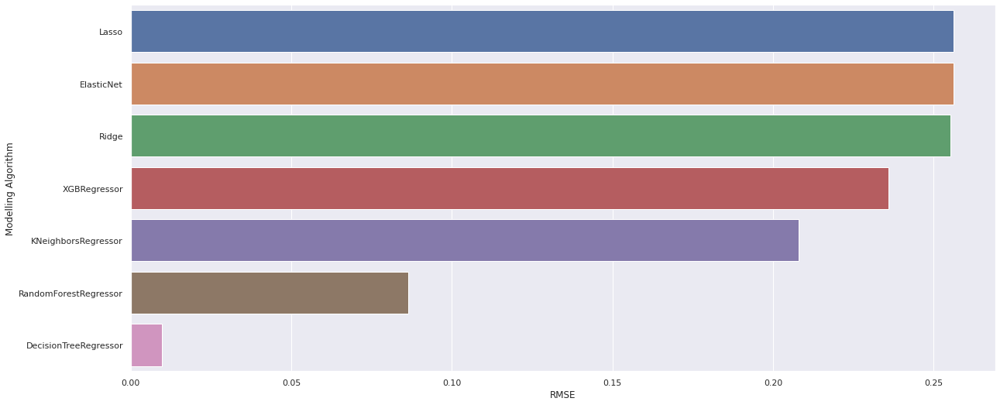

In [ ]:
# Barplot to identify the best performing modelling algorithm
a4_dims = (20, 8.7)
fig, ax = pyplot.subplots(figsize=a4_dims)
sns.barplot(data=rmse_table, x='RMSE', y='Modelling Algorithm');

# Reference

* https://xgboost.readthedocs.io/en/stable/
* https://lightgbm.readthedocs.io/en/latest/
* https://scikit-learn.org/
* https://www.kaggle.com/sorashido/pubg-simple-lightgbm
* https://www.kaggle.com/somang1418/tuning-hyperparameters-under-10-minutes-lgbm
* Linear Regression with Scikit-Learn Jovian Aakash N S
* How to approach Machine Learning Problems Jovian Aakash N S
* Gradient Boosting Machines with XGBoost Jovian Aakash N S
* kaggle notebooks

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/adityahebbarnhnm/project-3


'https://jovian.ai/adityahebbarnhnm/project-3'